# Lecture 8: Working with GEOLocation Data
### [The Art of Analyzing Big Data - The Data Scientist’s Toolbox](https://www.ise.bgu.ac.il/labs/fire/lectures.html) 
### By Dr. Michael Fire

---

## 0. Package Setup
For this lecture, we are going to use the [TuriCreate](https://github.com/apple/turicreate), [spacy](https://spacy.io), [Cartopy](https://scitools.org.uk/cartopy/docs/latest/), [imageio](https://pypi.org/project/imageio/), [pymongo](https://pymongo.readthedocs.io/en/stable/), [GeoPandas](http://geopandas.org), [descartes](https://pypi.org/project/descartes/), [Geopy package](https://pypi.org/project/geopy/), and [Folium package](https://python-visualization.github.io/folium/) packages. Let's set them up:

In [37]:
!pip install turicreate
!pip install spaCy
!pip install pymongo
!pip install geopandas
!pip install descartes
!pip install geopy
!pip install folium


     |████████████████████████████████| 102kB 615kB/s ta 0:00:01


In [66]:
!conda install -y -c conda-forge imageio
!conda install -y -c conda-forge cartopy

Solving environment: done


==> WARNING: A newer version of conda exists. <==
  current version: 4.8.2
  latest version: 4.8.3

Please update conda by running

    $ conda update -n base conda



# All requested packages already installed.

Solving environment: done


==> WARNING: A newer version of conda exists. <==
  current version: 4.8.2
  latest version: 4.8.3

Please update conda by running

    $ conda update -n base conda



# All requested packages already installed.



Let's install and setup the [Kaggle](https://github.com/Kaggle/kaggle-api) package:

In [10]:
# Installing the Kaggle package
import json
!pip install kaggle 

#Important Note: complete this with your own key - after running this for the first time remmember to **remove** your API_KEY
api_token = {"username":"<Insert Your Kaggle User Name>","key":"<Insert Your Kaggle API key>"}

# creating kaggle.json file with the personal API-Key details 
# You can also put this file on your Google Drive
with open('~/.kaggle/kaggle.json', 'w') as file:
  json.dump(api_token, file)
!chmod 600 ~/.kaggle/kaggle.json

## 1. Working with PyMongo

To work with MongoDB first we need to [download and install it](https://www.mongodb.com/download-center/community).
In this notebook, we will be working with MongoDB. Therefore, I prefer to run the notebook locally on my laptop. Another option is to work with [MongoDB Atlas](https://www.mongodb.com/cloud/atlas).


Now let's run MongoDB and test the connection to it:

In [5]:
import pymongo
client = pymongo.MongoClient("mongodb://localhost:27017/")
client.list_database_names()

['admin', 'config', 'local', 'locations']

Now let's create a new collection and load the [US baby names](https://www.kaggle.com/kaggle/us-baby-names) dataset to the collection:

In [13]:
#!mkdir ./datasets
!mkdir ./datasets/us-baby-name

# download the dataset from Kaggle and unzip it
!kaggle datasets download kaggle/us-baby-names -f StateNames.csv -p ./datasets/

!unzip ./datasets/StateNames.csv.zip  -d ./datasets/us-baby-name/

 98%|█████████████████████████████████████▍| 30.0M/30.5M [00:04<00:00, 6.79MB/s]
100%|██████████████████████████████████████| 30.5M/30.5M [00:04<00:00, 6.42MB/s]
Archive:  ./datasets/StateNames.csv.zip
  inflating: ./datasets/us-baby-name/StateNames.csv  


In [15]:
import turicreate as tc
import turicreate.aggregate as agg


sf = tc.SFrame.read_csv("./datasets/us-baby-name/StateNames.csv")
sf

Finished parsing file /Users/michael/Dropbox (BGU)/massive data mining/ 2020/notebooks/datasets/us-baby-name/StateNames.csv

Parsing completed. Parsed 100 lines in 1.31749 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[int,str,int,str,str,int]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Read 1940415 lines. Lines per second: 1.30741e+06

Finished parsing file /Users/michael/Dropbox (BGU)/massive data mining/ 2020/notebooks/datasets/us-baby-name/StateNames.csv

Parsing completed. Parsed 5647426 lines in 2.93838 secs.

Id,Name,Year,Gender,State,Count
1,Mary,1910,F,AK,14
2,Annie,1910,F,AK,12
3,Anna,1910,F,AK,10
4,Margaret,1910,F,AK,8
5,Helen,1910,F,AK,7
6,Elsie,1910,F,AK,6
7,Lucy,1910,F,AK,6
8,Dorothy,1910,F,AK,5
9,Mary,1911,F,AK,12
10,Margaret,1911,F,AK,7


In [16]:
sf['Year_Count'] =  sf.apply(lambda r: (r['Year'], r['Count']))
g = sf.groupby(["State", "Name", "Gender"], {"years_list" : agg.CONCAT("Year_Count")})
g

Gender,Name,State,years_list
M,Ferman,LA,"[[1926.0, 5.0]]"
M,Holton,NC,"[[2013.0, 5.0]]"
F,Faiga,NJ,"[[1995.0, 5.0], [1999.0,5.0], [2007.0, 17.0], ..."
F,Carlie,MD,"[[1990.0, 6.0], [1997.0,7.0], [1998.0, 10.0], ..."
M,Beau,SC,"[[2014.0, 16.0], [1981.0,6.0], [2012.0, 7.0], ..."
F,Kaitlynn,WA,"[[1995.0, 19.0], [1996.0,26.0], [2003.0, 15.0], ..."
F,Tiny,NC,"[[1917.0, 5.0], [1936.0,5.0], [1920.0, 5.0], ..."
F,Cayla,NJ,"[[1993.0, 6.0], [1998.0,12.0], [1999.0, 14.0], ..."
M,Renardo,NC,"[[1983.0, 6.0]]"
M,Auther,SC,"[[1936.0, 5.0], [1937.0,5.0], [1920.0, 6.0], ..."


In [17]:
g['YearsCountDict'] = g['years_list'].apply(lambda l: {str(int(y)): int(c) for y,c in l})
g = g.remove_column("years_list")
g

Gender,Name,State,YearsCountDict
M,Ferman,LA,{'1926': 5}
M,Holton,NC,{'2013': 5}
F,Faiga,NJ,"{'1995': 5, '1999': 5,'2007': 17, '2008': 8, ..."
F,Carlie,MD,"{'1990': 6, '1997': 7,'1998': 10, '1992': 12, ..."
M,Beau,SC,"{'2014': 16, '1981': 6,'2012': 7, '2008': 7, ..."
F,Kaitlynn,WA,"{'1995': 19, '1996': 26,'2003': 15, '2008': 18, ..."
F,Tiny,NC,"{'1917': 5, '1936': 5,'1920': 5, '1932': 5, ..."
F,Cayla,NJ,"{'1993': 6, '1998': 12,'1999': 14, '2003': 12, ..."
M,Renardo,NC,{'1983': 6}
M,Auther,SC,"{'1936': 5, '1937': 5,'1920': 6, '1939': 5, ..."


Let's insert data from the SFrame object into a MongoDB collection:

In [18]:
db = client['baby_names'] # Created a new DB named baby_names 
collection = db['names']  # Created a new collection named names 

# insert each row as a document 
for r in g[:100]:
    collection.insert_one(r) 

print(f"Total documents {collection.count_documents({})}")


Total documents 100


Let's delete all the documents in the collection:

In [19]:
collection.delete_many({}) # delete all documents
print(f"Total documents {collection.count_documents({})}")

Total documents 0


In [20]:
collection.insert_many(g)
print(f"Total documents {collection.count_documents({})}")

Total documents 304918


Let's search for documents:

In [21]:
collection.find_one({ "Name": "Mary", "Gender": "F" })


{'_id': ObjectId('5eb51b889993d0175fb5f810'),
 'Gender': 'F',
 'Name': 'Mary',
 'State': 'CA',
 'YearsCountDict': {'1910': 295,
  '1915': 998,
  '1918': 1252,
  '1928': 1787,
  '1930': 1851,
  '1964': 2709,
  '1971': 1056,
  '1983': 751,
  '2004': 292,
  '1912': 534,
  '1916': 1091,
  '1921': 1697,
  '1929': 1713,
  '1945': 3019,
  '1947': 3460,
  '1953': 3400,
  '1980': 831,
  '1984': 756,
  '1985': 706,
  '1988': 707,
  '1991': 723,
  '1997': 446,
  '1999': 438,
  '2003': 304,
  '2005': 282,
  '2014': 171,
  '1944': 2975,
  '1946': 3147,
  '1950': 3134,
  '1963': 2608,
  '1965': 2240,
  '1966': 1852,
  '1974': 742,
  '1979': 806,
  '1996': 500,
  '1998': 428,
  '2010': 177,
  '2011': 201,
  '2012': 166,
  '1917': 1149,
  '1925': 1890,
  '1931': 1626,
  '1939': 1699,
  '1941': 1951,
  '1949': 3217,
  '1954': 3718,
  '1961': 2716,
  '1967': 1621,
  '1968': 1447,
  '1970': 1278,
  '1975': 729,
  '1977': 710,
  '1987': 649,
  '1990': 678,
  '1992': 706,
  '1993': 639,
  '1995': 550,
  '2

In [22]:
c =  list(collection.find({ "Name": "Mary", "Gender": "F" }))
list(c)



[{'_id': ObjectId('5eb51b889993d0175fb5f810'),
  'Gender': 'F',
  'Name': 'Mary',
  'State': 'CA',
  'YearsCountDict': {'1910': 295,
   '1915': 998,
   '1918': 1252,
   '1928': 1787,
   '1930': 1851,
   '1964': 2709,
   '1971': 1056,
   '1983': 751,
   '2004': 292,
   '1912': 534,
   '1916': 1091,
   '1921': 1697,
   '1929': 1713,
   '1945': 3019,
   '1947': 3460,
   '1953': 3400,
   '1980': 831,
   '1984': 756,
   '1985': 706,
   '1988': 707,
   '1991': 723,
   '1997': 446,
   '1999': 438,
   '2003': 304,
   '2005': 282,
   '2014': 171,
   '1944': 2975,
   '1946': 3147,
   '1950': 3134,
   '1963': 2608,
   '1965': 2240,
   '1966': 1852,
   '1974': 742,
   '1979': 806,
   '1996': 500,
   '1998': 428,
   '2010': 177,
   '2011': 201,
   '2012': 166,
   '1917': 1149,
   '1925': 1890,
   '1931': 1626,
   '1939': 1699,
   '1941': 1951,
   '1949': 3217,
   '1954': 3718,
   '1961': 2716,
   '1967': 1621,
   '1968': 1447,
   '1970': 1278,
   '1975': 729,
   '1977': 710,
   '1987': 649,
   '199

We can also return only part of each document:

In [23]:
c =  list(collection.find({ "Name": "Mary", "Gender": "F" }, {'YearsCountDict':0})) # Exclude 'YearsCountDict' values
c[1]

{'_id': ObjectId('5eb51b889993d0175fb60b00'),
 'Gender': 'F',
 'Name': 'Mary',
 'State': 'LA'}

In [24]:
#regex query - Return only names that start with 'M' and ends with 'y'
query = { "Name": { "$regex": "^M.*y$" } } 
list(collection.find(query, {'YearsCountDict':0}))

[{'_id': ObjectId('5eb51b889993d0175fb5e8a9'),
  'Gender': 'F',
  'Name': 'Macy',
  'State': 'CA'},
 {'_id': ObjectId('5eb51b889993d0175fb5e9ea'),
  'Gender': 'F',
  'Name': 'Melody',
  'State': 'NH'},
 {'_id': ObjectId('5eb51b889993d0175fb5ea0d'),
  'Gender': 'F',
  'Name': 'Marely',
  'State': 'NV'},
 {'_id': ObjectId('5eb51b889993d0175fb5eb44'),
  'Gender': 'F',
  'Name': 'Margery',
  'State': 'NJ'},
 {'_id': ObjectId('5eb51b889993d0175fb5ebd2'),
  'Gender': 'F',
  'Name': 'Mahogany',
  'State': 'SC'},
 {'_id': ObjectId('5eb51b889993d0175fb5ebd9'),
  'Gender': 'F',
  'Name': 'Marley',
  'State': 'NC'},
 {'_id': ObjectId('5eb51b889993d0175fb5ed4d'),
  'Gender': 'F',
  'Name': 'Mazzy',
  'State': 'CA'},
 {'_id': ObjectId('5eb51b889993d0175fb5ed56'),
  'Gender': 'F',
  'Name': 'Mallory',
  'State': 'SC'},
 {'_id': ObjectId('5eb51b889993d0175fb5edf7'),
  'Gender': 'F',
  'Name': 'Mindy',
  'State': 'WA'},
 {'_id': ObjectId('5eb51b889993d0175fb5efaf'),
  'Gender': 'F',
  'Name': 'Mandy',

In [25]:
# search in nested documents
# returns all baby names that in 1990 more than 4000 babies were born with this name
query = { "YearsCountDict.1990":   {"$gt": 4000}}  
list(collection.find(query, {'YearsCountDict':0}))

[{'_id': ObjectId('5eb51b889993d0175fb5fbeb'),
  'Gender': 'M',
  'Name': 'David',
  'State': 'CA'},
 {'_id': ObjectId('5eb51b899993d0175fb66eb7'),
  'Gender': 'M',
  'Name': 'Michael',
  'State': 'TX'},
 {'_id': ObjectId('5eb51b899993d0175fb67e7f'),
  'Gender': 'M',
  'Name': 'Michael',
  'State': 'NY'},
 {'_id': ObjectId('5eb51b899993d0175fb6bfd9'),
  'Gender': 'M',
  'Name': 'Anthony',
  'State': 'CA'},
 {'_id': ObjectId('5eb51b899993d0175fb6c2b7'),
  'Gender': 'F',
  'Name': 'Ashley',
  'State': 'CA'},
 {'_id': ObjectId('5eb51b899993d0175fb6da47'),
  'Gender': 'M',
  'Name': 'Michael',
  'State': 'CA'},
 {'_id': ObjectId('5eb51b899993d0175fb6e54b'),
  'Gender': 'M',
  'Name': 'Andrew',
  'State': 'CA'},
 {'_id': ObjectId('5eb51b899993d0175fb78eaa'),
  'Gender': 'F',
  'Name': 'Jessica',
  'State': 'CA'},
 {'_id': ObjectId('5eb51b8a9993d0175fb8522b'),
  'Gender': 'M',
  'Name': 'Matthew',
  'State': 'CA'},
 {'_id': ObjectId('5eb51b8a9993d0175fb8607a'),
  'Gender': 'M',
  'Name': 'Jo

We can also sort the return results, or limit the number of results:

In [31]:
query = { "YearsCountDict.2000":   {"$gt": 1000}}  
list(collection.find(query, {'YearsCountDict':0}).sort("Name"))

[{'_id': ObjectId('5eb51b899993d0175fb78593'),
  'Gender': 'M',
  'Name': 'Aaron',
  'State': 'CA'},
 {'_id': ObjectId('5eb51b8a9993d0175fb8bd8c'),
  'Gender': 'F',
  'Name': 'Abigail',
  'State': 'TX'},
 {'_id': ObjectId('5eb51b8a9993d0175fb87b78'),
  'Gender': 'M',
  'Name': 'Adrian',
  'State': 'CA'},
 {'_id': ObjectId('5eb51b8a9993d0175fb88b2d'),
  'Gender': 'M',
  'Name': 'Alejandro',
  'State': 'CA'},
 {'_id': ObjectId('5eb51b899993d0175fb7fb10'),
  'Gender': 'M',
  'Name': 'Alexander',
  'State': 'TX'},
 {'_id': ObjectId('5eb51b8b9993d0175fb99010'),
  'Gender': 'M',
  'Name': 'Alexander',
  'State': 'NY'},
 {'_id': ObjectId('5eb51b8b9993d0175fb9eee7'),
  'Gender': 'M',
  'Name': 'Alexander',
  'State': 'CA'},
 {'_id': ObjectId('5eb51b899993d0175fb79496'),
  'Gender': 'F',
  'Name': 'Alexandra',
  'State': 'CA'},
 {'_id': ObjectId('5eb51b899993d0175fb79893'),
  'Gender': 'F',
  'Name': 'Alexis',
  'State': 'CA'},
 {'_id': ObjectId('5eb51b8a9993d0175fb8c926'),
  'Gender': 'F',
  '

In [32]:
query = { "YearsCountDict.2000":   {"$gt": 1000}}  
list(collection.find(query, {'YearsCountDict':0}).sort("Name").limit(2))


[{'_id': ObjectId('5eb51b899993d0175fb78593'),
  'Gender': 'M',
  'Name': 'Aaron',
  'State': 'CA'},
 {'_id': ObjectId('5eb51b8a9993d0175fb8bd8c'),
  'Gender': 'F',
  'Name': 'Abigail',
  'State': 'TX'}]

## 2. Visualizing  Geographic Data 

## 2.1 Working with Cartopy

In this section, we are going to use [Cartopy](https://scitools.org.uk/cartopy/docs/latest/):


We can easily use Cartopy to plot various [map projections](https://scitools.org.uk/cartopy/docs/latest/crs/projections.html#cartopy.crs.Robinson):

ax type: <class 'cartopy.mpl.geoaxes.GeoAxesSubplot'>


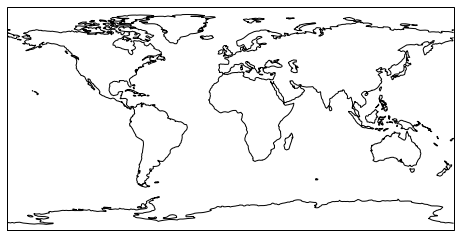

In [35]:
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

plt.figure(figsize=(8, 8))
ax = plt.axes(projection=ccrs.PlateCarree())
print(f"ax type: {type(ax)}")
ax.coastlines()

ax type: <class 'cartopy.mpl.geoaxes.GeoAxesSubplot'>


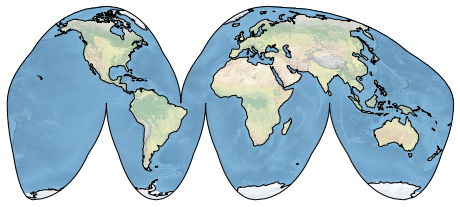

In [36]:
plt.figure(figsize=(8, 8))
ax = plt.axes(projection=ccrs.InterruptedGoodeHomolosine())
print(f"ax type: {type(ax)}")
ax.coastlines()
ax.stock_img() # Add a standard image to the map -> add some colors :)

Let's add some data to the map:

Text(0.1278, 52, 'London')

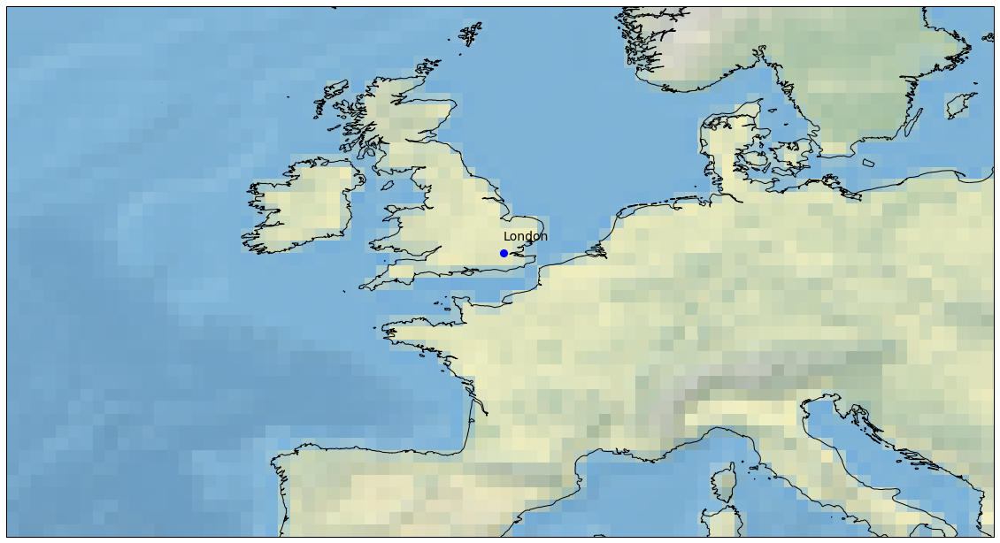

In [37]:
plt.figure(figsize=(20, 20))
ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=0))
ax.set_extent([-20, 20, 40, 60])  # Select a specific part of the map
ax.coastlines(resolution='10m', color='black', linewidth=1) # draw with batter coaslines resolution
ax.stock_img() # add colors 

london_lon, london_lat = 0.1278, 51.5074
plt.plot(london_lon, london_lat,
         color='blue', marker='o', markersize=8
         )
ax.text(0.1278, 52, 'London', fontsize=14)


Let's plot a map with all the [capital cities' names](http://techslides.com/list-of-countries-and-capitals): 

In [38]:
import turicreate as tc


!wget -O ./datasets/country-capitals.csv http://techslides.com/demos/country-capitals.csv
sf = tc.SFrame.read_csv("./datasets/country-capitals.csv", error_bad_lines=False)
sf

--2020-05-08 11:58:21--  http://techslides.com/demos/country-capitals.csv
Resolving techslides.com (techslides.com)... 107.170.15.66
Connecting to techslides.com (techslides.com)|107.170.15.66|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 13643 (13K) [application/octet-stream]
Saving to: ‘./datasets/country-capitals.csv’

./datasets/country- 100%[===================>]  13.32K  --.-KB/s    in 0s      

2020-05-08 11:58:22 (129 MB/s) - ‘./datasets/country-capitals.csv’ saved [13643/13643]



Unexpected characters after last column. "Central America"
Parse failed at token ending at: 
	United States,Washington, D.C.,38.883333,-77.000000,US,Central America^
Successfully parsed 6 tokens: 
	0: United States
	1: Washington
	2: D.C.
	3: 38.8833
	4: -77
	5: US

Unexpected characters after last column. "Australia"
Parse failed at token ending at: 
	US Minor Outlying Islands,Washington, D.C.,38.883333,-77.000000,UM,Australia^
Successfully parsed 6 tokens: 
	0: US Minor O ... ng Islands
	1: Washington
	2: D.C.
	3: 38.8833
	4: -77
	5: UM

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[str,str,float,float,str,str]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


2 lines failed to parse correctly

Finished parsing file /Users/michael/Dropbox (BGU)/massive data mining/ 2020/notebooks/datasets/country-capitals.csv

Parsing completed. Parsed 100 lines in 0.027236 secs.

Unable to interpret "D.C." as a integer
Parse failed at token ending at: 
	United States,Washington, D.C.,^38.883333,-77.000000,US,Central America
Successfully parsed 2 tokens: 
	0: United States
	1: Washington

Unable to interpret "D.C." as a integer
Parse failed at token ending at: 
	US Minor Outlying Islands,Washington, D.C.,^38.883333,-77.000000,UM,Australia
Successfully parsed 2 tokens: 
	0: US Minor O ... ng Islands
	1: Washington

2 lines failed to parse correctly

Finished parsing file /Users/michael/Dropbox (BGU)/massive data mining/ 2020/notebooks/datasets/country-capitals.csv

Parsing completed. Parsed 243 lines in 0.006348 secs.

CountryName,CapitalName,CapitalLatitude,CapitalLongitude,CountryCode,ContinentName
Somaliland,Hargeisa,9.55,44.05,NULL,Africa
South Georgia and SouthSandwich Islands ...,King Edward Point,-54.283333,-36.5,GS,Antarctica
French Southern andAntarctic Lands ...,Port-aux-Français,-49.35,70.216667,TF,Antarctica
Palestine,Jerusalem,31.766666666666666,35.233333,PS,Asia
Aland Islands,Mariehamn,60.116667,19.9,AX,Europe
Nauru,Yaren,-0.5477,166.920867,NR,Australia
Saint Martin,Marigot,18.0731,-63.0822,MF,North America
Tokelau,Atafu,-9.166667,-171.833333,TK,Australia
Western Sahara,El-Aaiún,27.153611,-13.203333,EH,Africa
Afghanistan,Kabul,34.516666666666666,69.183333,AF,Asia


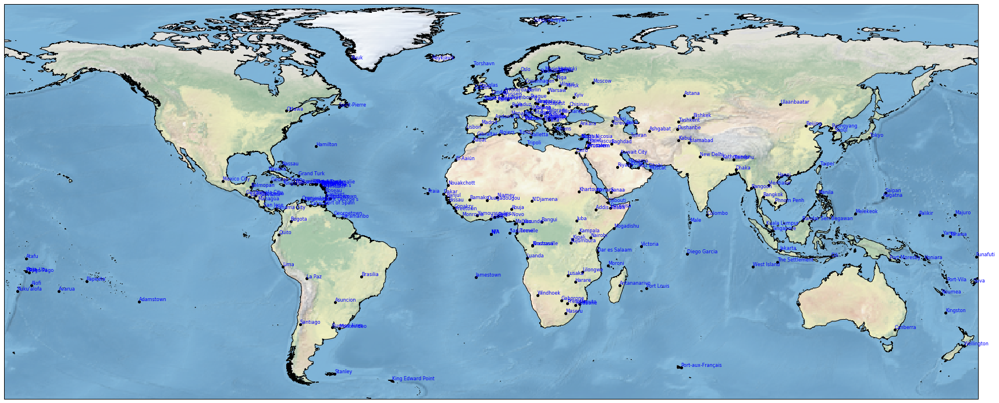

In [39]:
def draw_map(w_size=30, h_size=30):
    plt.figure(figsize=(w_size, h_size))
    ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=0))
    ax.coastlines(resolution='10m', color='black', linewidth=1) # draw with batter coaslines resolution
    return ax
ax = draw_map()
for r in sf:
    lon, lat, name = r['CapitalLongitude'], r['CapitalLatitude'], r['CapitalName']
    plt.plot(lon, lat,
         color='black', marker='o', markersize=4,transform=ccrs.PlateCarree(),
         )
    ax.text(lon, lat+0.2, name, fontsize=8, color="blue", transform=ccrs.PlateCarree(),)

ax.stock_img() # add colors

Text(-0.083333, 52.0, 'London')

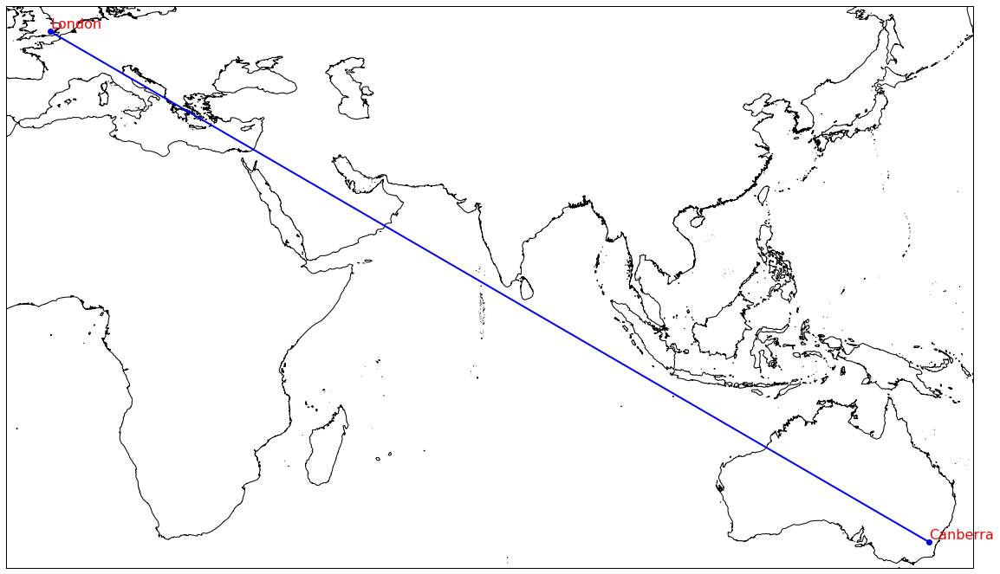

In [40]:
r = sf[sf['CapitalName'] == 'Canberra'][0]
canb_long, canb_lat = r['CapitalLongitude'], r['CapitalLatitude']
r = sf[sf['CapitalName'] == 'London'][0]
lon_long, lon_lat = r['CapitalLongitude'], r['CapitalLatitude']

ax = draw_map(20,40)

plt.plot([lon_long, canb_long], [lon_lat, canb_lat],
         color='blue', linewidth=2, marker='o',
         )
ax.text(canb_long, canb_lat+0.5, "Canberra", fontsize=16, color="red", transform=ccrs.PlateCarree())
ax.text(lon_long, lon_lat+0.5, "London", fontsize=16, color="red", transform=ccrs.PlateCarree())

Let's plot a line connecting London and Canberra:

Text(-0.083333, 52.0, 'London')

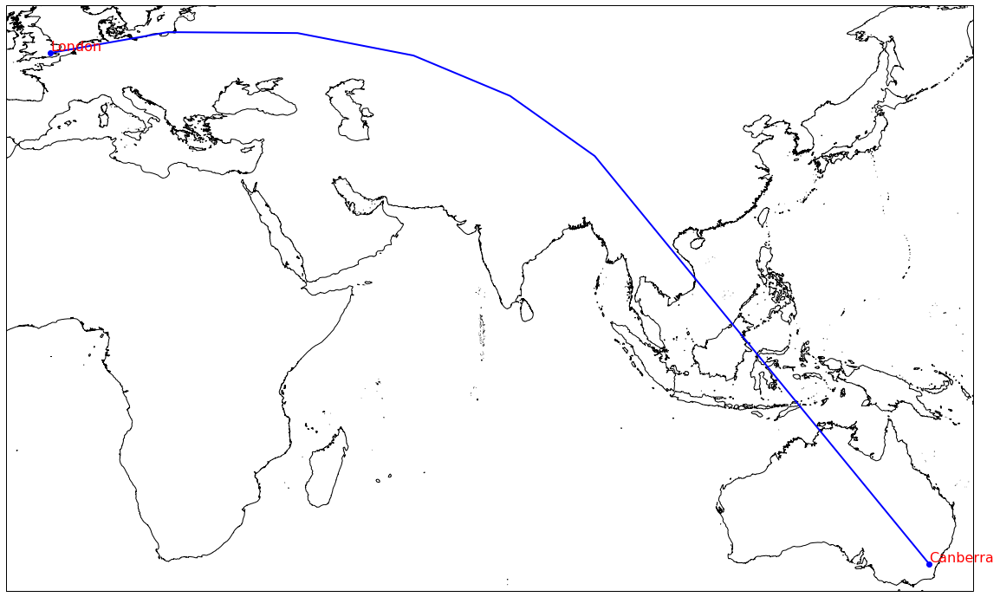

In [41]:
r = sf[sf['CapitalName'] == 'Canberra'][0]
canb_long, canb_lat = r['CapitalLongitude'], r['CapitalLatitude']
r = sf[sf['CapitalName'] == 'London'][0]
lon_long, lon_lat = r['CapitalLongitude'], r['CapitalLatitude']

ax = draw_map(20,40)

plt.plot([lon_long, canb_long], [lon_lat, canb_lat],
         color='blue', linewidth=2, marker='o',
         transform=ccrs.Geodetic(),
         )
ax.text(canb_long, canb_lat+0.5, "Canberra", fontsize=16, color="red", transform=ccrs.PlateCarree())
ax.text(lon_long, lon_lat+0.5, "London", fontsize=16, color="red", transform=ccrs.PlateCarree())

Let's draw another connecting line:


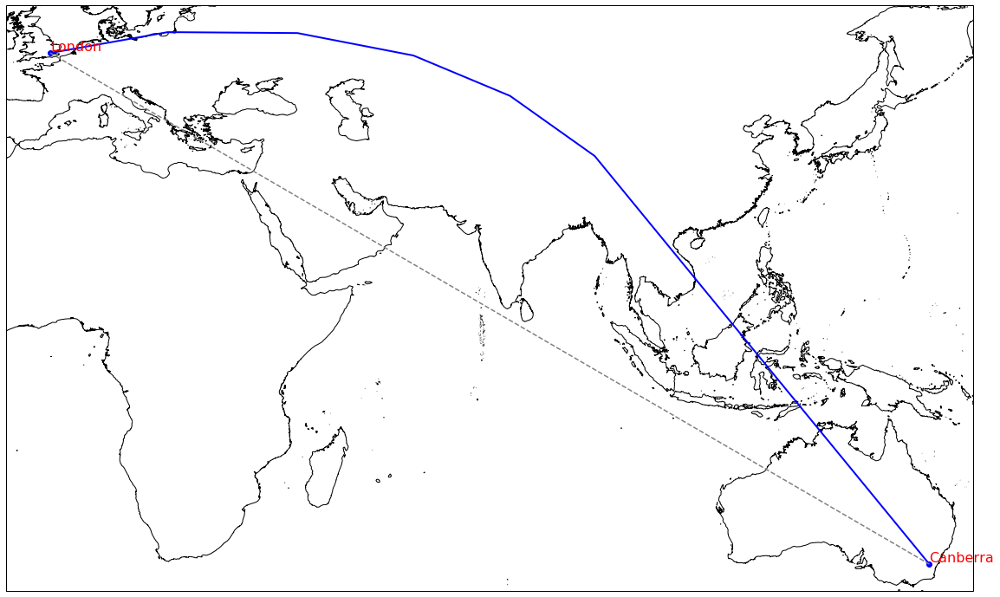

In [42]:
ax = draw_map(20,40)

plt.plot([lon_long, canb_long], [lon_lat, canb_lat],
         color='blue', linewidth=2, marker='o',
         transform=ccrs.Geodetic(),
         )
ax.text(canb_long, canb_lat+0.5, "Canberra", fontsize=16, color="red", transform=ccrs.PlateCarree())
ax.text(lon_long, lon_lat+0.5, "London", fontsize=16, color="red", transform=ccrs.PlateCarree())

plt.plot([lon_long, canb_long], [lon_lat, canb_lat],
         color='gray', linestyle='--',
         transform=ccrs.PlateCarree(),
         )

We can add additional features to each map:

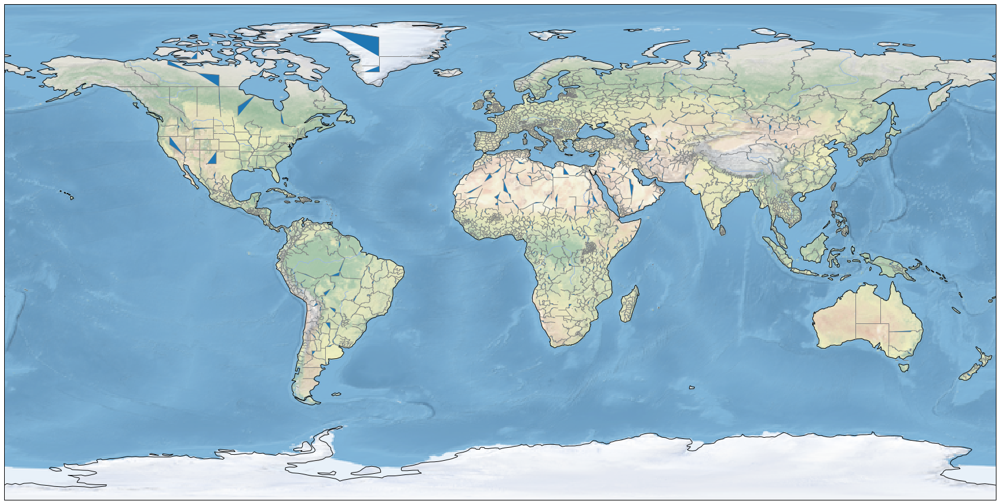

In [43]:
import cartopy.feature as cfeature

fig = plt.figure(figsize=(30,30))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
ax.stock_img()

# Create a feature for States from Natural Earth. See https://www.naturalearthdata.com/features/
states_provinces = cfeature.NaturalEarthFeature(
    category='cultural',
    name='admin_1_states_provinces_lines',
    scale='10m',
    )
#it is possible to add land, rivers,lakes, borders,costlines features
ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.RIVERS)
ax.add_feature(states_provinces, edgecolor='gray')

### 2.1.1  The US Elections

Let move to look at a map of the US states:

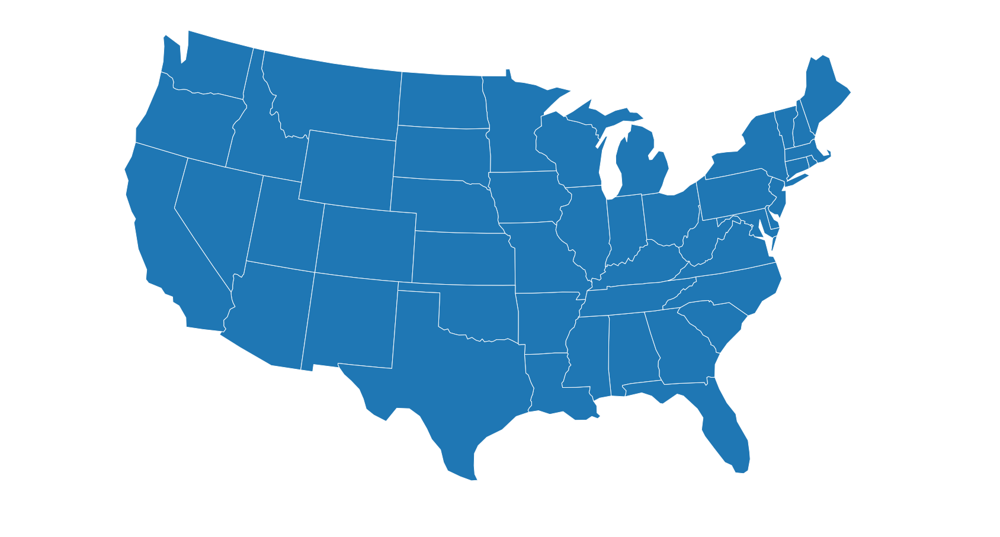

In [52]:
import cartopy.io.shapereader as shpreader

fig = plt.figure(figsize=(30,30))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.LambertConformal())
ax.set_extent([-125, -66.5, 20, 50], crs= ccrs.Geodetic())

ax.background_patch.set_visible(False)
ax.outline_patch.set_visible(False)

shapename = 'admin_1_states_provinces_lakes_shp'
states_shp = shpreader.natural_earth(resolution='110m',category='cultural', name=shapename)
ax.add_geometries(shpreader.Reader(states_shp).geometries(), ccrs.PlateCarree(), edgecolor='#FFFFFF')


Each shape record contains attributes and bounds:

In [53]:
k = list(shpreader.Reader(states_shp).records())[0]
print(f"Bounds: {k.bounds}")
k.attributes

Bounds: (-97.22894344764502, 43.500187486335385, -89.5997116839191, 49.38928538674973)


{'scalerank': 2,
 'featurecla': 'Admin-1 scale rank',
 'adm1_code': 'USA-3514',
 'diss_me': 3514,
 'adm1_cod_1': 'USA-3514',
 'iso_3166_2': 'US-MN',
 'wikipedia': 'http://en.wikipedia.org/wiki/Minnesota',
 'sr_sov_a3': 'US1',
 'sr_adm0_a3': 'USA',
 'iso_a2': 'US',
 'adm0_sr': 1,
 'admin0_lab': 2,
 'name': 'Minnesota',
 'name_alt': 'MN|Minn.',
 'name_local': '',
 'type': 'State',
 'type_en': 'State',
 'code_local': 'US32',
 'code_hasc': 'US.MN',
 'note': '',
 'hasc_maybe': '',
 'region': 'Midwest',
 'region_cod': '',
 'region_big': 'West North Central',
 'big_code': '',
 'provnum_ne': 0,
 'gadm_level': 1,
 'check_me': 10,
 'scaleran_1': 2,
 'datarank': 1,
 'abbrev': 'Minn.',
 'postal': 'MN',
 'area_sqkm': 0.0,
 'sameascity': -99,
 'labelrank': 0,
 'featurec_1': 'Admin-1 scale rank',
 'admin': 'United States of America',
 'name_len': 9,
 'mapcolor9': 1,
 'mapcolor13': 1}

Let's color the states according to their [U.S. President votes](https://dataverse.harvard.edu/dataset.xhtml?persistentId=doi:10.7910/DVN/42MVDX):


In [58]:
import turicreate as tc
import turicreate.aggregate as agg
dataset_path = "./datasets/1976-2016-president.csv"
sf = tc.SFrame.read_csv(dataset_path)
sf = sf["year", "state",'state_po', "party", "candidatevotes"]
sf["party"] = sf["party"].apply(lambda s: "democrat" if "democrat" in s else s ) # there is Minnesota Democratic–Farmer–Labor
d_sf = sf[sf["party"] == "democrat"]
r_sf = sf[sf["party"] == "republican"]
v_sf =  d_sf.join(r_sf,on={"state":"state", "year":"year"})
v_sf = v_sf.rename({'candidatevotes': 'democrat_votes', 'candidatevotes.1': 'republican_votes' })
v_sf['result'] = v_sf.apply(lambda r: 'democrat' if r['democrat_votes'] > r['republican_votes'] else "republican")
v_sf

Finished parsing file /Users/michael/Dropbox (BGU)/massive data mining/ 2020/notebooks/datasets/1976-2016-president.csv

Parsing completed. Parsed 100 lines in 0.032195 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[int,str,str,int,int,int,str,str,str,str,int,int,int,str]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Finished parsing file /Users/michael/Dropbox (BGU)/massive data mining/ 2020/notebooks/datasets/1976-2016-president.csv

Parsing completed. Parsed 3740 lines in 0.01495 secs.

year,state,state_po,party,democrat_votes,state_po.1,party.1,republican_votes
1976,Alabama,AL,democrat,659170,AL,republican,504070
1976,Alaska,AK,democrat,44058,AK,republican,71555
1976,Arizona,AZ,democrat,295602,AZ,republican,418642
1976,Arkansas,AR,democrat,498604,AR,republican,267903
1976,California,CA,democrat,3742284,CA,republican,3882244
1976,Colorado,CO,democrat,460801,CO,republican,584278
1976,Connecticut,CT,democrat,647895,CT,republican,719261
1976,Delaware,DE,democrat,122461,DE,republican,109780
1976,District of Columbia,DC,democrat,137818,DC,republican,27873
1976,Florida,FL,democrat,1636000,FL,republican,1469531


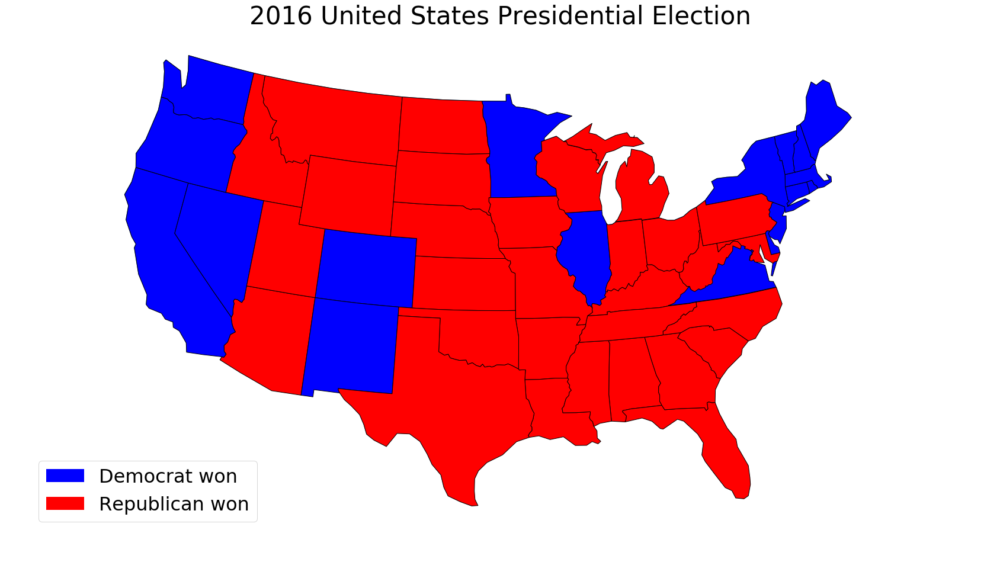

In [61]:
import matplotlib.patches as mpatches

def draw_us_map():
    fig = plt.figure(figsize=(30,30))
    ax = fig.add_subplot(1, 1, 1, projection=ccrs.LambertConformal())
    ax.set_extent([-125, -66.5, 20, 50], crs= ccrs.Geodetic())

    ax.background_patch.set_visible(False)
    ax.outline_patch.set_visible(False)

    shapename = 'admin_1_states_provinces_lakes_shp'
    states_shp = shpreader.natural_earth(resolution='110m',category='cultural', name=shapename)
    ax.add_geometries(shpreader.Reader(states_shp).geometries(), ccrs.PlateCarree())
    return ax

def create_election_result_by_year(sf, year):
    sf =  sf[sf["year"] == year]
    results_dict = {}
    for r in sf:
        results_dict[r['state']] = r['result']
        results_dict[r['state_po']] = r['result'] # adding additional name options for each state

    ax = draw_us_map()
    
    for state_record in shpreader.Reader(states_shp).records():
        edgecolor = 'black'
        if 'postal' not in state_record.attributes:
            continue
        
        name = state_record.attributes['postal']
        facecolor = 'green'
        if name not in results_dict:
            facecolor = 'green'
        elif results_dict[name] == 'democrat':
            facecolor = 'blue'
        elif results_dict[name] == 'republican':
            facecolor = 'red'
        ax.add_geometries([state_record.geometry], ccrs.PlateCarree(),
                          facecolor=facecolor, edgecolor=edgecolor)
    #let's add legend
    ax.set_title(f'{year} United States Presidential Election', fontsize=42)
    rebuplican = mpatches.Rectangle((0, 0), 1, 1, facecolor="red")
    democrat = mpatches.Rectangle((0, 0), 1, 1, facecolor="blue")
    labels = ['Democrat won','Republican won']
    ax.legend([democrat, rebuplican], labels,
              loc='lower left', bbox_to_anchor=(0.025, 0.05), fancybox=True,
             prop={'size': 32})
    return ax

create_election_result_by_year(v_sf, 2016)

In [67]:
from tqdm import tqdm
import imageio # need install imageio 
!mkdir ./images
!mkdir ./images/elections
#Creating image for the election in each year
years = list(v_sf['year'].unique().sort())
images_path = "./images/elections/"
images_list = []
for y in tqdm(years):
    ax = create_election_result_by_year(v_sf, y)
    img_path = f"{images_path}/{y}_elections.png"
    plt.savefig(img_path)
    images_list.append(img_path)
    plt.clf()

import imageio
images = []
for filename in images_list:
    images.append(imageio.imread(filename))
imageio.mimsave(f"{images_path}/all_elections.gif", images, duration=1 )

mkdir: ./images: File exists
mkdir: ./images/elections: File exists


100%|██████████| 11/11 [00:09<00:00,  1.15it/s]


<Figure size 2160x2160 with 0 Axes>

<Figure size 2160x2160 with 0 Axes>

<Figure size 2160x2160 with 0 Axes>

<Figure size 2160x2160 with 0 Axes>

<Figure size 2160x2160 with 0 Axes>

<Figure size 2160x2160 with 0 Axes>

<Figure size 2160x2160 with 0 Axes>

<Figure size 2160x2160 with 0 Axes>

<Figure size 2160x2160 with 0 Axes>

<Figure size 2160x2160 with 0 Axes>

<Figure size 2160x2160 with 0 Axes>

![SegmentLocal](./images/elections/all_elections.gif "segment")


### 2.1.2 Exploring Flights

In this section we will explore flight routes. Let's start by loading [the flights dataset](https://www.kaggle.com/freddejn/flights) with over 5.8 flights 
into an SFrame object:

In [70]:
#!mkdir ./datasets
!mkdir ./datasets/flights

# download the dataset from Kaggle and unzip it
!kaggle datasets download freddejn/flights  -p ./datasets/flights

!unzip ./datasets/flights/*.zip  -d ./datasets/flights/

Archive:  ./datasets/flights/flights.zip
  inflating: ./datasets/flights/L_AIRPORT.csv  
  inflating: ./datasets/flights/L_AIRPORT_ID.csv  
  inflating: ./datasets/flights/cleaned_and_sampled_flights_v2.csv  
  inflating: ./datasets/flights/flights.csv  


In [95]:
import turicreate as tc
import turicreate.aggregate as agg

dataset_path = "./datasets/flights"
sf = tc.SFrame.read_csv(f"{dataset_psth}/flights.csv")
sf

Finished parsing file /Users/michael/Dropbox (BGU)/massive data mining/ 2020/notebooks/datasets/flights/flights.csv

Parsing completed. Parsed 100 lines in 0.828921 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[int,int,int,int,str,int,str,str,str,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,str,int,int,int,int,int]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Read 520345 lines. Lines per second: 328598

Read 3627333 lines. Lines per second: 498810

Finished parsing file /Users/michael/Dropbox (BGU)/massive data mining/ 2020/notebooks/datasets/flights/flights.csv

Parsing completed. Parsed 5819079 lines in 11.2635 secs.

YEAR,MONTH,DAY,DAY_OF_WEEK,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,ORIGIN_AIRPORT,DESTINATION_AIRPORT,SCHEDULED_DEPARTURE
2015,1,1,4,AS,98,N407AS,ANC,SEA,5
2015,1,1,4,AA,2336,N3KUAA,LAX,PBI,10
2015,1,1,4,US,840,N171US,SFO,CLT,20
2015,1,1,4,AA,258,N3HYAA,LAX,MIA,20
2015,1,1,4,AS,135,N527AS,SEA,ANC,25
2015,1,1,4,DL,806,N3730B,SFO,MSP,25
2015,1,1,4,NK,612,N635NK,LAS,MSP,25
2015,1,1,4,US,2013,N584UW,LAX,CLT,30
2015,1,1,4,AA,1112,N3LAAA,SFO,DFW,30
2015,1,1,4,DL,1173,N826DN,LAS,ATL,30


Let's calculate how many flights took place in each route:

In [96]:
g = sf.groupby(['ORIGIN_AIRPORT', 'DESTINATION_AIRPORT'], {'total_flights': agg.COUNT()})
g.sort('total_flights', ascending=False)

DESTINATION_AIRPORT,ORIGIN_AIRPORT,total_flights
LAX,SFO,13744
SFO,LAX,13457
LAX,JFK,12016
JFK,LAX,12015
LAX,LAS,9715
ORD,LGA,9639
LAS,LAX,9594
LGA,ORD,9575
JFK,SFO,8440
SFO,JFK,8437


Let's create a flight network and visualize it using Cytoscape:

In [97]:
import networkx as nx

ng = nx.DiGraph()
for r in g:
    ng.add_edge(r['ORIGIN_AIRPORT'], r['DESTINATION_AIRPORT'], weight=r['total_flights'])
nx.write_gml(ng, f"{dataset_psth}/flights_network.gml")
nx.info(ng)


'Name: \nType: DiGraph\nNumber of nodes: 629\nNumber of edges: 8609\nAverage in degree:  13.6868\nAverage out degree:  13.6868'

![SegmentLocal](./datasets/flights/flights.png "segment")

We can see that the network consists of two main components. Additionally,
in each component, there are few central nodes (according to vertices' betweenness measure).
Let's select only one of the components  and draw the routes on a map using the airport location data from
the [OpenFlight website](https://openflights.org/data.html#license):

In [98]:
cc = nx.weakly_connected_components(ng)
l = list(cc)
l

[{'10135',
  '10136',
  '10140',
  '10141',
  '10146',
  '10154',
  '10155',
  '10157',
  '10158',
  '10165',
  '10170',
  '10185',
  '10208',
  '10257',
  '10268',
  '10279',
  '10299',
  '10333',
  '10372',
  '10397',
  '10408',
  '10423',
  '10431',
  '10434',
  '10469',
  '10529',
  '10551',
  '10561',
  '10577',
  '10581',
  '10599',
  '10620',
  '10627',
  '10631',
  '10666',
  '10685',
  '10693',
  '10713',
  '10721',
  '10728',
  '10731',
  '10732',
  '10739',
  '10747',
  '10754',
  '10779',
  '10781',
  '10785',
  '10792',
  '10800',
  '10821',
  '10849',
  '10868',
  '10874',
  '10918',
  '10926',
  '10980',
  '10990',
  '10994',
  '11003',
  '11013',
  '11042',
  '11049',
  '11057',
  '11066',
  '11067',
  '11076',
  '11097',
  '11109',
  '11111',
  '11122',
  '11140',
  '11146',
  '11150',
  '11193',
  '11203',
  '11252',
  '11259',
  '11267',
  '11274',
  '11278',
  '11292',
  '11298',
  '11308',
  '11315',
  '11337',
  '11413',
  '11423',
  '11433',
  '11447',
  '11471',

In [99]:
l[0]

{'10135',
 '10136',
 '10140',
 '10141',
 '10146',
 '10154',
 '10155',
 '10157',
 '10158',
 '10165',
 '10170',
 '10185',
 '10208',
 '10257',
 '10268',
 '10279',
 '10299',
 '10333',
 '10372',
 '10397',
 '10408',
 '10423',
 '10431',
 '10434',
 '10469',
 '10529',
 '10551',
 '10561',
 '10577',
 '10581',
 '10599',
 '10620',
 '10627',
 '10631',
 '10666',
 '10685',
 '10693',
 '10713',
 '10721',
 '10728',
 '10731',
 '10732',
 '10739',
 '10747',
 '10754',
 '10779',
 '10781',
 '10785',
 '10792',
 '10800',
 '10821',
 '10849',
 '10868',
 '10874',
 '10918',
 '10926',
 '10980',
 '10990',
 '10994',
 '11003',
 '11013',
 '11042',
 '11049',
 '11057',
 '11066',
 '11067',
 '11076',
 '11097',
 '11109',
 '11111',
 '11122',
 '11140',
 '11146',
 '11150',
 '11193',
 '11203',
 '11252',
 '11259',
 '11267',
 '11274',
 '11278',
 '11292',
 '11298',
 '11308',
 '11315',
 '11337',
 '11413',
 '11423',
 '11433',
 '11447',
 '11471',
 '11481',
 '11503',
 '11525',
 '11537',
 '11540',
 '11577',
 '11587',
 '11603',
 '11612',


In [85]:
l[1]

{'ABE',
 'ABI',
 'ABQ',
 'ABR',
 'ABY',
 'ACK',
 'ACT',
 'ACV',
 'ACY',
 'ADK',
 'ADQ',
 'AEX',
 'AGS',
 'AKN',
 'ALB',
 'ALO',
 'AMA',
 'ANC',
 'APN',
 'ASE',
 'ATL',
 'ATW',
 'AUS',
 'AVL',
 'AVP',
 'AZO',
 'BDL',
 'BET',
 'BFL',
 'BGM',
 'BGR',
 'BHM',
 'BIL',
 'BIS',
 'BJI',
 'BLI',
 'BMI',
 'BNA',
 'BOI',
 'BOS',
 'BPT',
 'BQK',
 'BQN',
 'BRD',
 'BRO',
 'BRW',
 'BTM',
 'BTR',
 'BTV',
 'BUF',
 'BUR',
 'BWI',
 'BZN',
 'CAE',
 'CAK',
 'CDC',
 'CDV',
 'CEC',
 'CHA',
 'CHO',
 'CHS',
 'CID',
 'CIU',
 'CLD',
 'CLE',
 'CLL',
 'CLT',
 'CMH',
 'CMI',
 'CMX',
 'CNY',
 'COD',
 'COS',
 'COU',
 'CPR',
 'CRP',
 'CRW',
 'CSG',
 'CVG',
 'CWA',
 'DAB',
 'DAL',
 'DAY',
 'DBQ',
 'DCA',
 'DEN',
 'DFW',
 'DHN',
 'DIK',
 'DLG',
 'DLH',
 'DRO',
 'DSM',
 'DTW',
 'DVL',
 'EAU',
 'ECP',
 'EGE',
 'EKO',
 'ELM',
 'ELP',
 'ERI',
 'ESC',
 'EUG',
 'EVV',
 'EWN',
 'EWR',
 'EYW',
 'FAI',
 'FAR',
 'FAT',
 'FAY',
 'FCA',
 'FLG',
 'FLL',
 'FNT',
 'FSD',
 'FSM',
 'FWA',
 'GCC',
 'GCK',
 'GEG',
 'GFK',
 'GGG',
 'GJT',


In [100]:
g.sort('total_flights', ascending=False)

DESTINATION_AIRPORT,ORIGIN_AIRPORT,total_flights
LAX,SFO,13744
SFO,LAX,13457
LAX,JFK,12016
JFK,LAX,12015
LAX,LAS,9715
ORD,LGA,9639
LAS,LAX,9594
LGA,ORD,9575
JFK,SFO,8440
SFO,JFK,8437


In [101]:
g = g[g.apply(lambda r: r['ORIGIN_AIRPORT'] in l[1] and r['DESTINATION_AIRPORT'] in l[1] )]
g.materialize()
g

DESTINATION_AIRPORT,ORIGIN_AIRPORT,total_flights
PSG,JNU,332
HOU,BNA,1225
KOA,OGG,814
SLC,SEA,3463
DEN,PDX,3423
ORD,IAD,1745
DSM,DFW,857
LAS,SNA,2412
LAS,SEA,5009
ROC,DTW,304


In [88]:
l[1]

{'ABE',
 'ABI',
 'ABQ',
 'ABR',
 'ABY',
 'ACK',
 'ACT',
 'ACV',
 'ACY',
 'ADK',
 'ADQ',
 'AEX',
 'AGS',
 'AKN',
 'ALB',
 'ALO',
 'AMA',
 'ANC',
 'APN',
 'ASE',
 'ATL',
 'ATW',
 'AUS',
 'AVL',
 'AVP',
 'AZO',
 'BDL',
 'BET',
 'BFL',
 'BGM',
 'BGR',
 'BHM',
 'BIL',
 'BIS',
 'BJI',
 'BLI',
 'BMI',
 'BNA',
 'BOI',
 'BOS',
 'BPT',
 'BQK',
 'BQN',
 'BRD',
 'BRO',
 'BRW',
 'BTM',
 'BTR',
 'BTV',
 'BUF',
 'BUR',
 'BWI',
 'BZN',
 'CAE',
 'CAK',
 'CDC',
 'CDV',
 'CEC',
 'CHA',
 'CHO',
 'CHS',
 'CID',
 'CIU',
 'CLD',
 'CLE',
 'CLL',
 'CLT',
 'CMH',
 'CMI',
 'CMX',
 'CNY',
 'COD',
 'COS',
 'COU',
 'CPR',
 'CRP',
 'CRW',
 'CSG',
 'CVG',
 'CWA',
 'DAB',
 'DAL',
 'DAY',
 'DBQ',
 'DCA',
 'DEN',
 'DFW',
 'DHN',
 'DIK',
 'DLG',
 'DLH',
 'DRO',
 'DSM',
 'DTW',
 'DVL',
 'EAU',
 'ECP',
 'EGE',
 'EKO',
 'ELM',
 'ELP',
 'ERI',
 'ESC',
 'EUG',
 'EVV',
 'EWN',
 'EWR',
 'EYW',
 'FAI',
 'FAR',
 'FAT',
 'FAY',
 'FCA',
 'FLG',
 'FLL',
 'FNT',
 'FSD',
 'FSM',
 'FWA',
 'GCC',
 'GCK',
 'GEG',
 'GFK',
 'GGG',
 'GJT',


Let's use the [Locations of Airports dataset](https://www.kaggle.com/flashgordon/locations-of-airports) to visualize the flights network on a map:

In [104]:
# download the dataset from Kaggle and unzip it
!kaggle datasets download flashgordon/locations-of-airports  -p ./datasets/flights

!unzip ./datasets/flights/locations-of-airports.zip  -d ./datasets/flights/

  0%|                                               | 0.00/23.6k [00:00<?, ?B/s]
100%|███████████████████████████████████████| 23.6k/23.6k [00:00<00:00, 322kB/s]
Archive:  ./datasets/flights/locations-of-airports.zip
  inflating: ./datasets/flights/Locations.csv  


In [112]:
sf = tc.SFrame.read_csv('./datasets/flights/Locations.csv')
sf.materialize()
sf

Finished parsing file /Users/michael/Dropbox (BGU)/massive data mining/ 2020/notebooks/datasets/flights/Locations.csv

Parsing completed. Parsed 100 lines in 0.025282 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[str,float,float]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Finished parsing file /Users/michael/Dropbox (BGU)/massive data mining/ 2020/notebooks/datasets/flights/Locations.csv

Parsing completed. Parsed 1435 lines in 0.006379 secs.

Address,Latitude,Longitude
BTI,70.1340026855,-143.582000732
LUR,68.87509918,-166.1100006
PIZ,69.73290253,-163.0050049
ITO,19.721399307251,-155.048004150391
ORL,28.545499801636,-81.332901000977
BTT,66.91390228,-151.529007
Z84,64.301201,-149.119995
UTO,65.99279785,-153.7039948
FYU,66.5715026855469,-145.25
SVW,61.09740067,-155.5740051


In [114]:
airports_set = set(g['DESTINATION_AIRPORT']) | set(g['ORIGIN_AIRPORT'])
sf = sf[sf['Address'].apply(lambda a: a in airports_set)]
sf.materialize()
sf

Address,Latitude,Longitude
ITO,19.721399307251,-155.048004150391
FSM,35.3366012573242,-94.3674011230469
GFK,47.949299,-97.176102
TTN,40.2766990661621,-74.8134994506836
BOS,42.36429977,-71.00520325
OAK,37.7212982177734,-122.221000671387
OMA,41.3031997680664,-95.8940963745117
OGG,20.8985996246338,-156.429992675781
ICT,37.6498985290527,-97.4330978393555
MCI,39.2976,-94.713898


In [111]:
airports_set

{1}

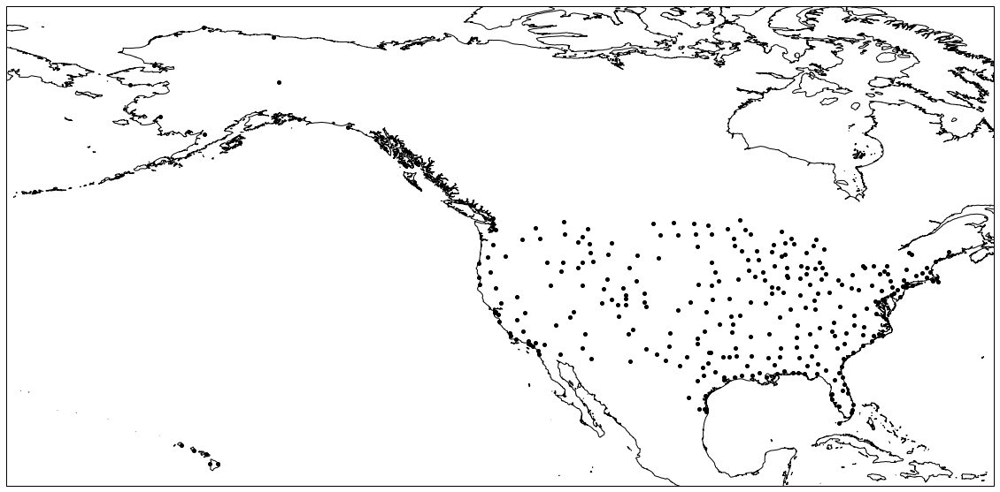

In [115]:
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
%matplotlib inline

def draw_map(w_size=30, h_size=30):
    plt.figure(figsize=(w_size, h_size))
    ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=0))
    ax.coastlines(resolution='10m', color='black', linewidth=1) # draw with batter coaslines resolution
    return ax

ax = draw_map(20,40)

for  r in sf:
    lon = r['Longitude']
    lat = r['Latitude']
    plt.plot(lon, lat,
         color='black', marker='o', markersize=4,transform=ccrs.PlateCarree(),
         )



We can observe that all the airports are in the US. Let's use a US map:

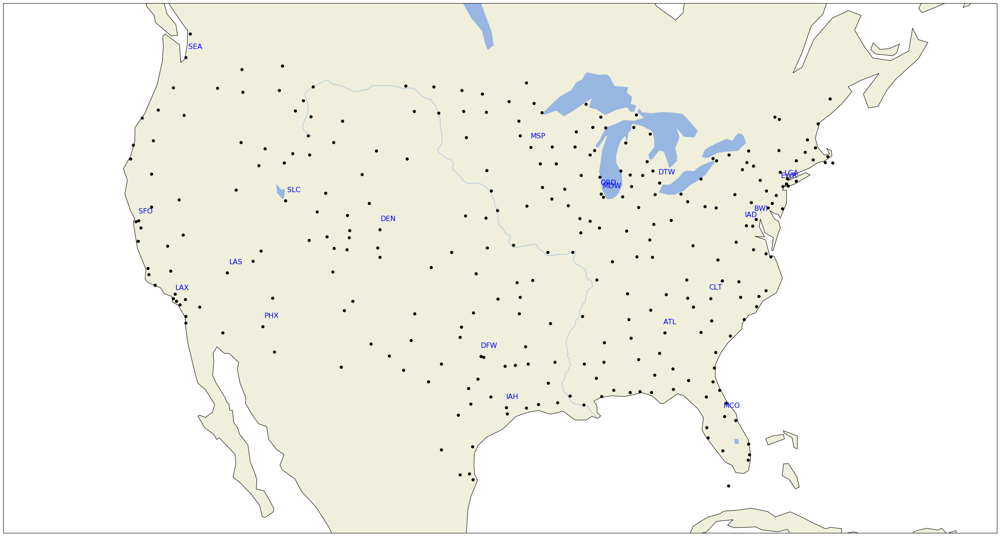

In [117]:
import matplotlib.patches as mpatches
import cartopy.io.shapereader as shpreader
import cartopy.feature as cfeature
import operator

def draw_aiports(top_airports_num=20):
    fig = plt.figure(figsize=(40,40))
    ax = plt.axes(projection=ccrs.LambertConformal())
    ax.set_extent([-125, -66.5, 20, 50], crs= ccrs.Geodetic())
    ax.add_feature(cfeature.LAND)
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.RIVERS)
    ax.add_feature(cfeature.LAKES)


    top_airports = sorted(dict(h.degree()).items(), key=operator.itemgetter(1), reverse=True)[:top_airports_num]
    top_set = set([a[0] for a in top_airports])
    for r in sf:
        lon = r['Longitude']
        lat = r['Latitude']
        plt.plot(lon, lat,
             color='black', marker='o', markersize=6,transform=ccrs.PlateCarree(),
             )
        
        if r["Address"] not in top_set:
            continue
        ax.text(lon, lat+0.5, r["Address"], fontsize=16, color="blue", transform=ccrs.PlateCarree())
    return ax
h = ng.subgraph(l[1])
draw_aiports()

In [118]:
g = g.join(sf, on={"ORIGIN_AIRPORT":"Address"})
g = g.rename({'Latitude':'OLatitude', 'Longitude': 'OLongitude' })
g = g.join(sf, on={"DESTINATION_AIRPORT":"Address"})
g = g.rename({'Latitude':'DLatitude', 'Longitude': 'DLongitude' })
g                                                                         
                                                                                        

DESTINATION_AIRPORT,ORIGIN_AIRPORT,total_flights,OLatitude,OLongitude,DLatitude
PSG,JNU,332,58.3549995422363,-134.57600402832,56.80170059
HOU,BNA,1225,36.1245002746582,-86.6781997680664,29.64539909
KOA,OGG,814,20.8985996246338,-156.429992675781,19.7388000488281
SLC,SEA,3463,47.4490013122559,-122.30899810791,40.7883987426758
DEN,PDX,3423,45.58869934,-122.5979996,39.861698150635
ORD,IAD,1745,38.94449997,-77.45580292,41.97859955
DSM,DFW,857,32.896800994873,-97.0380020141602,41.5340003967285
LAS,SNA,2412,33.67570114,-117.8679962,36.08010101
LAS,SEA,5009,47.4490013122559,-122.30899810791,36.08010101
ROC,DTW,304,42.2123985290527,-83.353401184082,43.1189002990723


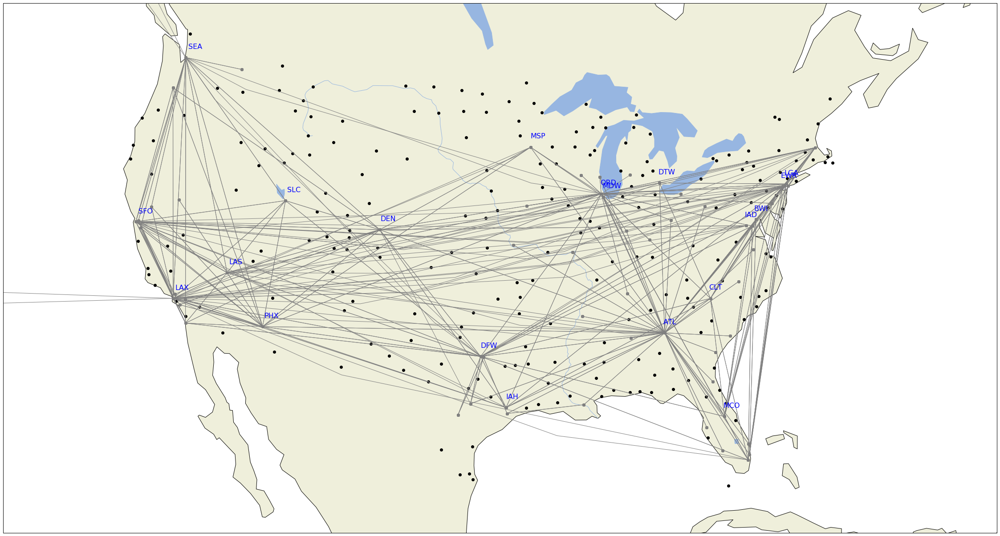

In [119]:
ax = draw_aiports()

for r in g.sort('total_flights', ascending=False)[:400]:
    plt.plot([r['OLongitude'], r['DLongitude']], [r['OLatitude'], r['DLatitude']],
         color='gray', linewidth=1, marker='o',
         transform=ccrs.PlateCarree(),
         )
                 

## 2.2 Working with GeoPandas

In this section, we are going to use [GeoPandas](http://geopandas.org) to work with geographic datasets.
GeoPandas is an open source project to make working with geospatial data in Python easier by extending the datatypes used by pandas to allow spatial operations on geometric types. 

In [1]:
# These examples are inspired from http://geopandas.org/mapping.html
import geopandas
import matplotlib.pyplot as plt
%matplotlib inline

world = geopandas.read_file(geopandas.datasets.get_path('naturalearth_lowres'))
world.head(10)

,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,920938,Oceania,Fiji,FJI,8374.0,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,53950935,Africa,Tanzania,TZA,150600.0,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,603253,Africa,W. Sahara,ESH,906.5,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
3,35623680,North America,Canada,CAN,1674000.0,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
4,326625791,North America,United States of America,USA,18560000.0,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."
5,18556698,Asia,Kazakhstan,KAZ,460700.0,"POLYGON ((87.35997 49.21498, 86.59878 48.54918..."
6,29748859,Asia,Uzbekistan,UZB,202300.0,"POLYGON ((55.96819 41.30864, 55.92892 44.99586..."
7,6909701,Oceania,Papua New Guinea,PNG,28020.0,"MULTIPOLYGON (((141.00021 -2.60015, 142.73525 ..."
8,260580739,Asia,Indonesia,IDN,3028000.0,"MULTIPOLYGON (((141.00021 -2.60015, 141.01706 ..."
9,44293293,South America,Argentina,ARG,879400.0,"MULTIPOLYGON (((-68.63401 -52.63637, -68.25000..."


<class 'shapely.geometry.multipolygon.MultiPolygon'>


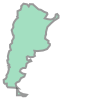

In [2]:
print(type(world.geometry[0]))
world.geometry[9]


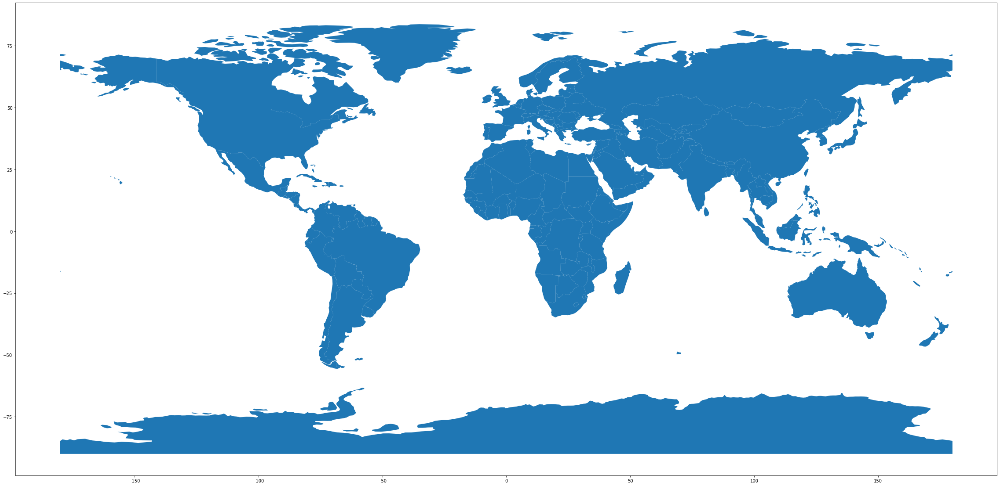

In [3]:
world.plot(figsize=(40,40))

In [4]:
cities = geopandas.read_file(geopandas.datasets.get_path('naturalearth_cities'))
cities.head(10)

,name,geometry
0,Vatican City,POINT (12.45339 41.90328)
1,San Marino,POINT (12.44177 43.93610)
2,Vaduz,POINT (9.51667 47.13372)
3,Luxembourg,POINT (6.13000 49.61166)
4,Palikir,POINT (158.14997 6.91664)
5,Majuro,POINT (171.38000 7.10300)
6,Funafuti,POINT (179.21665 -8.51665)
7,Melekeok,POINT (134.62655 7.48740)
8,Monaco,POINT (7.40691 43.73965)
9,Tarawa,POINT (173.01757 1.33819)


Let's put the cities on the world-map:

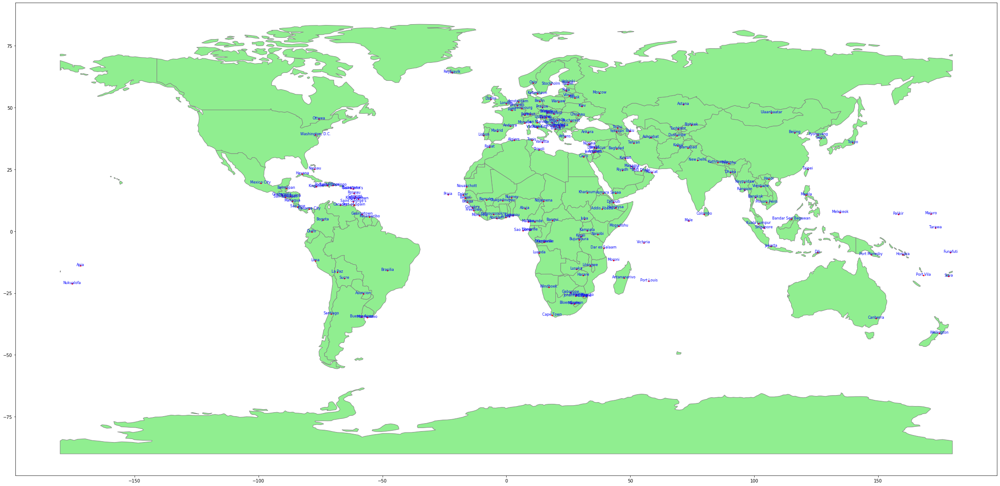

In [5]:
ax = world.plot(color='lightgreen', edgecolor='gray',figsize=(40,40))
cities.plot(ax=ax, marker='o', color='red', markersize=6);
# ading labels
for idx, row in cities.iterrows():
    pt = row['geometry']
    plt.annotate(s=row['name'], xy=(pt.x,pt.y),
                 horizontalalignment='center', fontsize=8,color="blue")

Let's color the maps according to each country's population size:

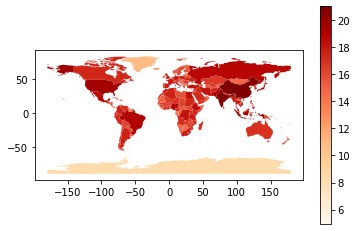

In [6]:
import math
fig, ax = plt.subplots()

ax.set_aspect('equal')

world['pop_est_log'] = world['pop_est'].apply(lambda i: math.log(i) if i >0 else 0)
world.plot(ax=ax, column="pop_est_log",  cmap='OrRd', legend=True  )


Let's plot the US states using [shape file](https://www.naturalearthdata.com/downloads/50m-cultural-vectors/50m-admin-1-states-provinces/) from Natural Earth, and GeoPandas:

,featurecla,scalerank,adm1_code,diss_me,iso_3166_2,wikipedia,iso_a2,adm0_sr,name,name_alt,...,name_nl,name_pl,name_pt,name_ru,name_sv,name_tr,name_vi,name_zh,ne_id,geometry
0,Admin-1 scale rank,2,AUS-2651,2651,AU-WA,None,AU,6,Western Australia,None,...,West-Australië,Australia Zachodnia,Austrália Ocidental,Западная Австралия,Western Australia,Batı Avustralya,Tây Úc,西澳大利亚州,1159315805,"MULTIPOLYGON (((113.13181 -25.95199, 113.14823..."
1,Admin-1 scale rank,2,AUS-2650,2650,AU-NT,None,AU,6,Northern Territory,None,...,Noordelijk Territorium,Terytorium Północne,Território do Norte,Северная территория,Northern Territory,Kuzey Toprakları,Lãnh thổ Bắc Úc,北領地,1159315809,"MULTIPOLYGON (((129.00196 -25.99901, 129.00196..."
2,Admin-1 scale rank,2,AUS-2655,2655,AU-SA,None,AU,3,South Australia,None,...,Zuid-Australië,Australia Południowa,Austrália Meridional,Южная Австралия,South Australia,Güney Avustralya,Nam Úc,南澳大利亚州,1159313267,"MULTIPOLYGON (((129.00196 -31.69266, 129.00196..."
3,Admin-1 scale rank,2,AUS-2657,2657,AU-QLD,None,AU,5,Queensland,None,...,Queensland,Queensland,Queensland,Квинсленд,Queensland,Queensland,Queensland,昆士蘭州,1159315807,"MULTIPOLYGON (((138.00196 -25.99901, 138.00174..."
4,Admin-1 scale rank,2,AUS-2660,2660,AU-TAS,None,AU,5,Tasmania,None,...,Tasmanië,Tasmania,Tasmânia,Тасмания,Tasmanien,Tasmanya,Tasmania,塔斯馬尼亞州,1159313261,"MULTIPOLYGON (((147.31246 -43.28038, 147.34238..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,Admin-1 scale rank,2,USA-3540,3540,US-VT,http://en.wikipedia.org/wiki/Vermont,US,1,Vermont,VT,...,Vermont,Vermont,Vermont,Вермонт,Vermont,Vermont,Vermont,佛蒙特州,1159315305,"POLYGON ((-73.35218 45.00542, -73.18201 45.005..."
96,Admin-1 scale rank,2,USA-3519,3519,US-WA,http://en.wikipedia.org/wiki/Washington_(state),US,6,Washington,WA|Wash.,...,Washington,Waszyngton,Washington,Вашингтон,Washington,Vaşington,Washington,华盛顿州,1159309547,"MULTIPOLYGON (((-122.78878 48.99303, -122.6863..."
97,Admin-1 scale rank,2,USA-3553,3553,US-WI,http://en.wikipedia.org/wiki/Wisconsin,US,1,Wisconsin,WI|Wis.,...,Wisconsin,Wisconsin,Wisconsin,Висконсин,Wisconsin,Wisconsin,Wisconsin,威斯康辛州,1159315321,"POLYGON ((-90.65058 42.51298, -90.65733 42.520..."
98,Admin-1 scale rank,2,USA-3554,3554,US-WV,http://en.wikipedia.org/wiki/West_Virginia,US,1,West Virginia,WV|W.Va.,...,West Virginia,Wirginia Zachodnia,Virgínia Ocidental,Западная Виргиния,West Virginia,Batı Virginia,Tây Virginia,西維吉尼亞州,1159315323,"POLYGON ((-81.96528 37.53973, -82.10346 37.570..."


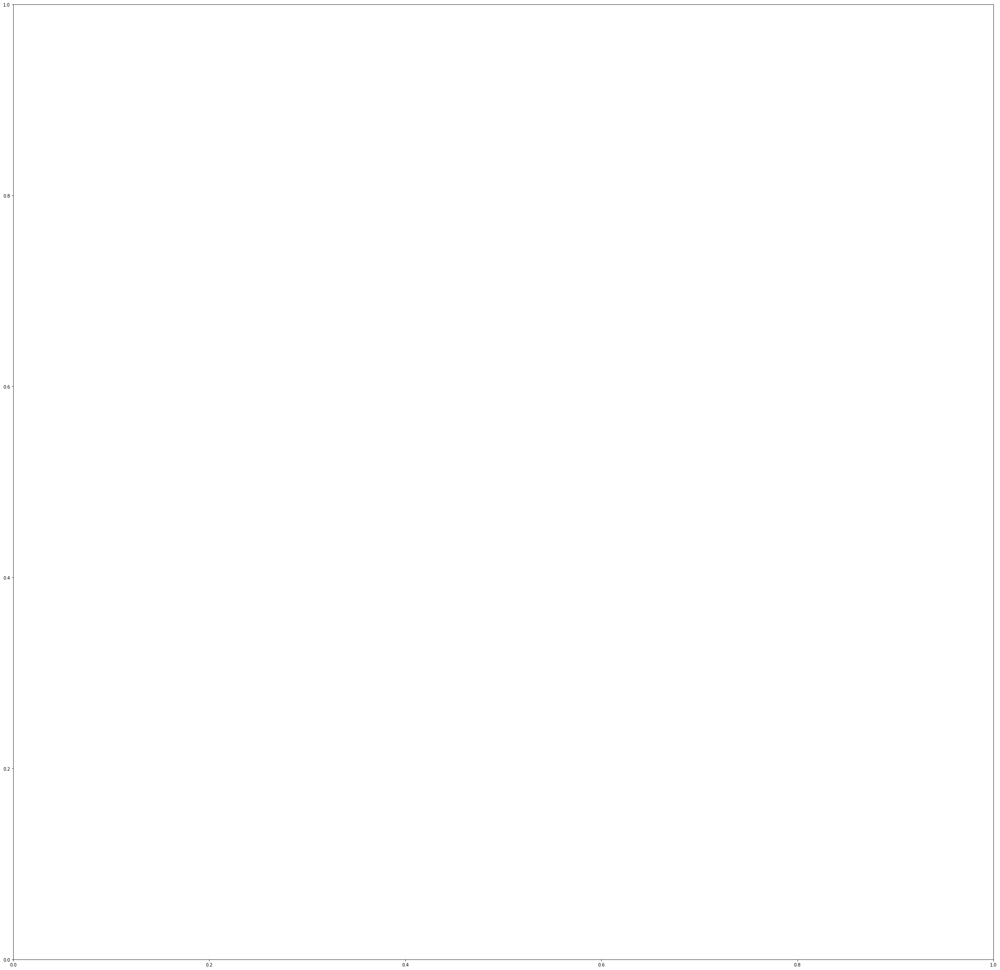

In [9]:
#!mkdir ./datasets/ne_50m_admin_1_states_provinces/
#!wget -O ./datasets/ne_50m_admin_1_states_provinces/ne_50m_admin_1_states_provinces.zip https://www.naturalearthdata.com/http//www.naturalearthdata.com/download/50m/cultural/ne_50m_admin_1_states_provinces.zip
#!unzip ./datasets/ne_50m_admin_1_states_provinces/ne_50m_admin_1_states_provinces.zip  -d ./datasets/ne_50m_admin_1_states_provinces/

fig, ax = plt.subplots(figsize=(40,40))
shp_path = "./datasets/ne_50m_admin_1_states_provinces/ne_50m_admin_1_states_provinces.shp"

#reading states data from shape file
gdf = geopandas.read_file(shp_path)
gdf



In [9]:
gdf

,featurecla,scalerank,adm1_code,diss_me,iso_3166_2,wikipedia,iso_a2,adm0_sr,name,name_alt,...,name_nl,name_pl,name_pt,name_ru,name_sv,name_tr,name_vi,name_zh,ne_id,geometry
0,Admin-1 scale rank,2,AUS-2651,2651,AU-WA,None,AU,6,Western Australia,None,...,West-Australië,Australia Zachodnia,Austrália Ocidental,Западная Австралия,Western Australia,Batı Avustralya,Tây Úc,西澳大利亚州,1159315805,"MULTIPOLYGON (((113.13181 -25.95199, 113.14823..."
1,Admin-1 scale rank,2,AUS-2650,2650,AU-NT,None,AU,6,Northern Territory,None,...,Noordelijk Territorium,Terytorium Północne,Território do Norte,Северная территория,Northern Territory,Kuzey Toprakları,Lãnh thổ Bắc Úc,北領地,1159315809,"MULTIPOLYGON (((129.00196 -25.99901, 129.00196..."
2,Admin-1 scale rank,2,AUS-2655,2655,AU-SA,None,AU,3,South Australia,None,...,Zuid-Australië,Australia Południowa,Austrália Meridional,Южная Австралия,South Australia,Güney Avustralya,Nam Úc,南澳大利亚州,1159313267,"MULTIPOLYGON (((129.00196 -31.69266, 129.00196..."
3,Admin-1 scale rank,2,AUS-2657,2657,AU-QLD,None,AU,5,Queensland,None,...,Queensland,Queensland,Queensland,Квинсленд,Queensland,Queensland,Queensland,昆士蘭州,1159315807,"MULTIPOLYGON (((138.00196 -25.99901, 138.00174..."
4,Admin-1 scale rank,2,AUS-2660,2660,AU-TAS,None,AU,5,Tasmania,None,...,Tasmanië,Tasmania,Tasmânia,Тасмания,Tasmanien,Tasmanya,Tasmania,塔斯馬尼亞州,1159313261,"MULTIPOLYGON (((147.31246 -43.28038, 147.34238..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,Admin-1 scale rank,2,USA-3540,3540,US-VT,http://en.wikipedia.org/wiki/Vermont,US,1,Vermont,VT,...,Vermont,Vermont,Vermont,Вермонт,Vermont,Vermont,Vermont,佛蒙特州,1159315305,"POLYGON ((-73.35218 45.00542, -73.18201 45.005..."
96,Admin-1 scale rank,2,USA-3519,3519,US-WA,http://en.wikipedia.org/wiki/Washington_(state),US,6,Washington,WA|Wash.,...,Washington,Waszyngton,Washington,Вашингтон,Washington,Vaşington,Washington,华盛顿州,1159309547,"MULTIPOLYGON (((-122.78878 48.99303, -122.6863..."
97,Admin-1 scale rank,2,USA-3553,3553,US-WI,http://en.wikipedia.org/wiki/Wisconsin,US,1,Wisconsin,WI|Wis.,...,Wisconsin,Wisconsin,Wisconsin,Висконсин,Wisconsin,Wisconsin,Wisconsin,威斯康辛州,1159315321,"POLYGON ((-90.65058 42.51298, -90.65733 42.520..."
98,Admin-1 scale rank,2,USA-3554,3554,US-WV,http://en.wikipedia.org/wiki/West_Virginia,US,1,West Virginia,WV|W.Va.,...,West Virginia,Wirginia Zachodnia,Virgínia Ocidental,Западная Виргиния,West Virginia,Batı Virginia,Tây Virginia,西維吉尼亞州,1159315323,"POLYGON ((-81.96528 37.53973, -82.10346 37.570..."


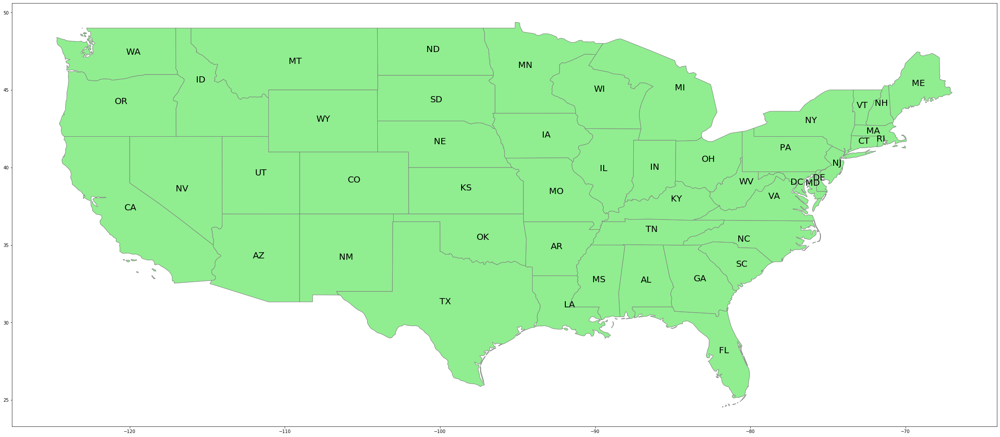

In [10]:
fig, ax = plt.subplots(figsize=(40,40))
shp_path = "./datasets/ne_50m_admin_1_states_provinces/ne_50m_admin_1_states_provinces.shp"

#reading states data from shape file
gdf = geopandas.read_file(shp_path)
gdf = gdf[gdf['iso_a2'] == 'US'] # selecting only US states wihtout Alaska & Hawaii
gdf = gdf[gdf['name'].apply(lambda n: n not in {'Alaska', 'Hawaii'})]
#Let's add states name # see also https://stackoverflow.com/questions/38899190/geopandas-label-polygons
gdf['repres_points'] = gdf['geometry'].apply(lambda x: x.representative_point())

for idx, row in gdf.iterrows():
    pt = row['repres_points']
    name = row['iso_3166_2'].replace("US-", "")
    plt.annotate(s=name, xy=(pt.x,pt.y),
                 horizontalalignment='center', fontsize=20,color="black")

gdf.plot(ax=ax, color='lightgreen', edgecolor='gray')

Now, let's analyze [Life on the Mississippi by Mark Twain](http://www.gutenberg.org/ebooks/245) and extract
locations which appear in his work:

In [14]:
!wget -O ./datasets/mark_twain.txt http://www.gutenberg.org/files/245/245-0.txt
!python -m spacy download en_core_web_lg # remember to restart the runtime 

In [12]:
import spacy
import operator

nlp = spacy.load('en_core_web_lg')


def get_locations_from_text(text):
    locations_dict= {}

    #using spaCy to get entities
    doc = nlp(text)

    for entity in doc.ents:
        label = entity.label_
        if label not in {'LOC', 'GPE'}:
            continue
        loc = entity.text.lower().strip()
        if len(loc) < 2:
            continue
        if loc not in locations_dict:
            locations_dict[loc] = 0
        locations_dict[loc] += 1
    return locations_dict

twain_full_work_path = "./datasets/mark_twain.txt"
txt = open(twain_full_work_path).read()
locations_dict = get_locations_from_text(txt)
locations_dict = {k:v for k,v in  locations_dict.items() if v>3}
print(sorted(locations_dict.items(), key=operator.itemgetter(1), reverse=True)[:20])
print(f"Number of locations {len(locations_dict.keys())}")

[('mississippi', 119), ('new orleans', 105), ('st. louis', 80), ('cairo', 31), ('vicksburg', 28), ('memphis', 26), ('missouri', 25), ('the\nriver', 23), ('arkansas', 22), ('south', 22), ('natchez', 20), ('earth', 20), ('the united states', 20), ('st. paul', 18), ('cincinnati', 17), ('ohio', 15), ('illinois', 15), ('new\norleans', 14), ('texas', 13), ('louisiana', 12)]
Number of locations 70


Using the , let's transfer locations mentioned  in the book to coordinates and draw them on the map:

In [16]:
!pip install geopy

     |████████████████████████████████| 112kB 508kB/s eta 0:00:01


In [17]:
from geopy.geocoders import Nominatim
geolocator = Nominatim(user_agent="Data Science Education App") #  Using OpenStreetMap Nominatim
location = geolocator.geocode("the missouri river")
print(location.address)
print((location.latitude, location.longitude))
print(location.raw)

Missouri River, Sully County, South Dakota, 64072, United States of America
(44.6042103, -100.6355825)
{'place_id': 235665012, 'licence': 'Data © OpenStreetMap contributors, ODbL 1.0. https://osm.org/copyright', 'osm_type': 'relation', 'osm_id': 1756890, 'boundingbox': ['38.5348721', '48.1497052', '-112.0153374', '-90.117707'], 'lat': '44.6042103', 'lon': '-100.6355825', 'display_name': 'Missouri River, Sully County, South Dakota, 64072, United States of America', 'class': 'waterway', 'type': 'river', 'importance': 0.7126739728744267}


In [20]:
from functools import lru_cache
from scipy.interpolate import interp1d # for transfaering font size
import time

@lru_cache(maxsize=256)
def get_location(loc):
    time.sleep(1)
    return geolocator.geocode(loc)
 

Skipping plottin Россия: (64.6863136, 97.7453061) 
Skipping plottin Europa: (51.0, 10.0) 
Skipping plottin Deutschland: (51.0834196, 10.4234469) 
Skipping plottin France: (46.603354, 1.8883335) 
Skipping plottin Italia: (42.6384261, 12.674297) 
Skipping plottin England, United Kingdom: (52.7954791, -0.5402402866174321) 
Skipping plottin America, Horst aan de Maas, Limburg, Nederland: (51.44770365, 5.966069282055592) 
Skipping plottin Canada: (61.0666922, -107.9917071) 
Skipping plottin Рівненська область, Україна: (51.2074112, 26.5208033) 
Skipping plottin 中国: (35.000074, 104.999927) 
Skipping plottin القاهرة, محافظة القاهرة, Egypt / مصر: (30.048819, 31.243666) 
Skipping plottin Hat Island, Kitikmeot Region, Nunavut, Canada: (68.33154189999999, -100.09088423305138) 
Skipping plottin water, Bern, Verwaltungskreis Bern-Mittelland, Verwaltungsregion Bern-Mittelland, Bern/Berne, 3005, Switzerland: (46.9341389, 7.4472821) 
Skipping plottin London, Greater London, England, SW1A 2DX, United K

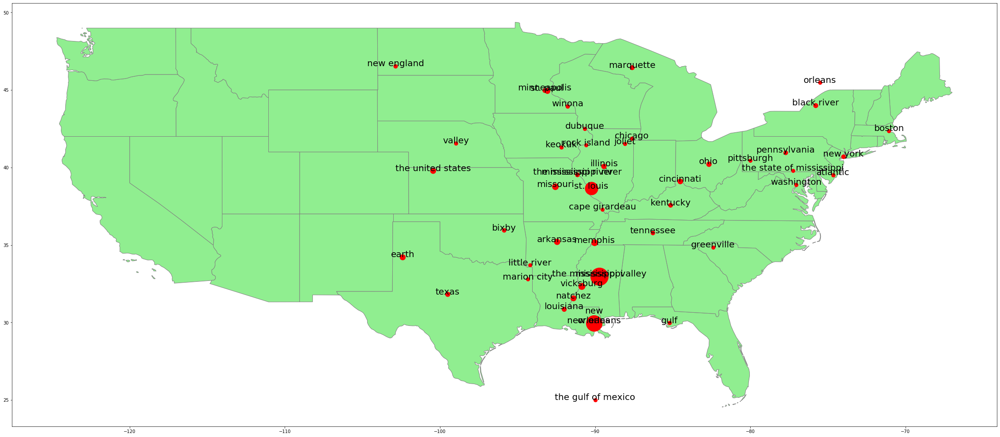

In [21]:
fig, ax = plt.subplots(figsize=(40,40))
gdf.plot(ax=ax, color='lightgreen', edgecolor='gray')

m = interp1d([4,max(locations_dict.values())],[8,40])

for loc, v in locations_dict.items():
    location = get_location(loc)
    if location is None:
        continue
    if not (-120 < location.longitude < -65) or not (57>location.latitude  > 25):
        print(f"Skipping plottin {location}: {(location.latitude, location.longitude)} ")
        continue
    
    
    plt.plot(location.longitude,location.latitude, marker='o', color='red', markersize=m(v))
    plt.annotate(s=loc, xy=(location.longitude,location.latitude),
                 horizontalalignment='center', fontsize=20,color="black")

Let's add the course of the river to the map:

In [23]:
[k for k in locations_dict.keys() if "river" in k]

['mississippi river',
 'the\nriver',
 'the mississippi river',
 'black river',
 'little river']

In [27]:
!wget -O ./datasets/ne_10m_rivers_lake_centerlines.zip https://www.naturalearthdata.com/http//www.naturalearthdata.com/download/10m/physical/ne_10m_rivers_lake_centerlines.zip
!unzip     ./datasets/ne_10m_rivers_lake_centerlines.zip -d ./datasets/ne_10m_rivers_lake_centerlines

--2020-05-08 15:12:35--  https://www.naturalearthdata.com/http//www.naturalearthdata.com/download/10m/physical/ne_10m_rivers_lake_centerlines.zip
Resolving www.naturalearthdata.com (www.naturalearthdata.com)... 66.147.242.194
Connecting to www.naturalearthdata.com (www.naturalearthdata.com)|66.147.242.194|:443... connected.
HTTP request sent, awaiting response... 302 Moved Temporarily
Location: http://naciscdn.org/naturalearth/10m/physical/ne_10m_rivers_lake_centerlines.zip [following]
--2020-05-08 15:12:37--  http://naciscdn.org/naturalearth/10m/physical/ne_10m_rivers_lake_centerlines.zip
Resolving naciscdn.org (naciscdn.org)... 146.201.97.163
Connecting to naciscdn.org (naciscdn.org)|146.201.97.163|:80... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://naciscdn.org/naturalearth/10m/physical/ne_10m_rivers_lake_centerlines.zip [following]
--2020-05-08 15:12:38--  https://naciscdn.org/naturalearth/10m/physical/ne_10m_rivers_lake_centerlines.zip

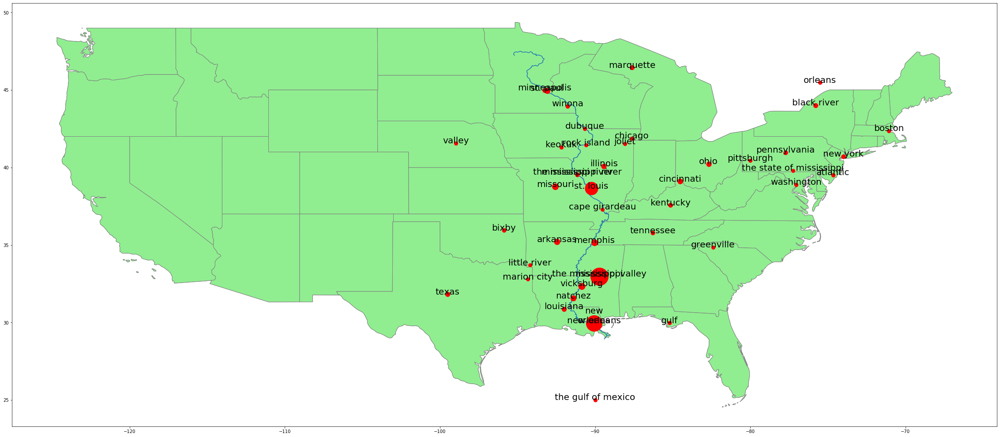

In [33]:
fig, ax = plt.subplots(figsize=(40,40))
ax = gdf.plot(ax=ax, color='lightgreen', edgecolor='gray')


gdf.plot(ax=ax, color='lightgreen', edgecolor='gray')

m = interp1d([4,max(locations_dict.values())],[8,40])

for loc, v in locations_dict.items():
    location = get_location(loc)
    if location is None:
        continue
    if not (-100 < location.longitude < -65) or not (57>location.latitude  > 25):
        continue
    
    
    plt.plot(location.longitude,location.latitude, marker='o', color='red', markersize=m(v))
    plt.annotate(s=loc, xy=(location.longitude,location.latitude),
                 horizontalalignment='center', fontsize=20,color="black")

#adding the Mississippi river
# data from Natural Earth https://www.naturalearthdata.com/downloads/10m-physical-vectors/10m-rivers-lake-centerlines/
river_shp_path = "./datasets/ne_10m_rivers_lake_centerlines/ne_10m_rivers_lake_centerlines.shp"
#reading states data from shape file
r_gdf = geopandas.read_file(river_shp_path)

r_gdf = r_gdf[r_gdf['name'] == 'Mississippi']
r_gdf.plot(ax=ax)


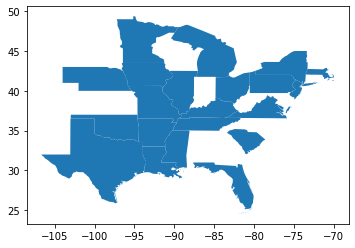

In [34]:
#Focusing only on states which are relevant to the entities
from shapely.geometry import Point
location_points = []
def is_poly_contains_point(poly, l):
    for pt in l:
        if pt.within(poly):
            return True
    return False

for loc, v in locations_dict.items():
    location = get_location(loc)
    if location is None:
        continue
    if not (-100 < location.longitude < -65) or not (57>location.latitude  > 25):
        continue
    location_points.append(Point(location.longitude,location.latitude))
gdf['is_relevant'] = gdf['geometry'].apply(lambda p: is_poly_contains_point(p,location_points))
gdf2 = gdf[gdf['is_relevant'] == True]
gdf2.plot()

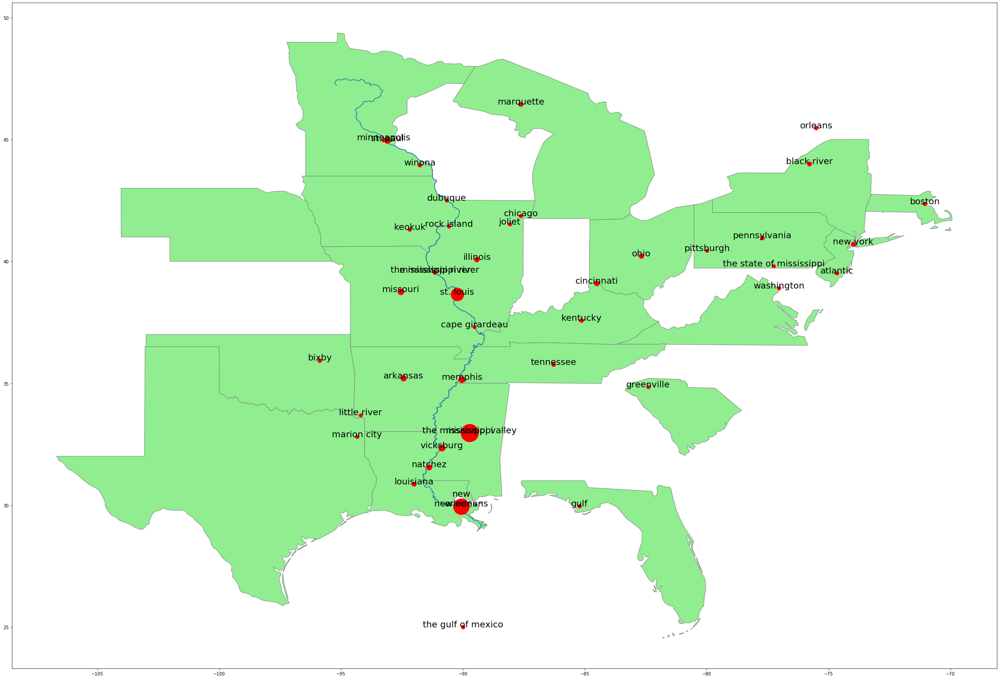

In [35]:
fig, ax = plt.subplots(figsize=(40,40))
ax = gdf2.plot(ax=ax, color='lightgreen', edgecolor='gray')
m = interp1d([4,max(locations_dict.values())],[8,40])

for loc, v in locations_dict.items():
    location = get_location(loc)
    if location is None:
        continue
    if not (-97 < location.longitude < -70) or not (57>location.latitude  > 25):
        continue
    
    
    plt.plot(location.longitude,location.latitude, marker='o', color='red', markersize=m(v))
    plt.annotate(s=loc, xy=(location.longitude,location.latitude),
                 horizontalalignment='center', fontsize=20,color="black")

#adding the mississippi river
# data from Natural Earth https://www.naturalearthdata.com/downloads/10m-physical-vectors/10m-rivers-lake-centerlines/
river_shp_path = "../../datasets/ne_10m_rivers_lake_centerlines/ne_10m_rivers_lake_centerlines.shp"
#reading states data from shape file
r_gdf = geopandas.read_file(river_shp_path)

r_gdf = r_gdf[r_gdf['name'] == 'Mississippi']
r_gdf.plot(ax=ax)



In [36]:
gdf2

,featurecla,scalerank,adm1_code,diss_me,iso_3166_2,wikipedia,iso_a2,adm0_sr,name,name_alt,...,name_pt,name_ru,name_sv,name_tr,name_vi,name_zh,ne_id,geometry,repres_points,is_relevant
51,Admin-1 scale rank,2,USA-3528,3528,US-AR,http://en.wikipedia.org/wiki/Arkansas,US,1,Arkansas,AR|Ark.,...,Arkansas,Арканзас,Arkansas,Arkansas,Arkansas,阿肯色州,1159315355,"POLYGON ((-89.70477 36.00157, -89.70932 35.983...",POINT (-92.47082 34.74907),True
58,Admin-1 scale rank,2,USA-3542,3542,US-FL,http://en.wikipedia.org/wiki/Florida,US,5,Florida,FL|Fla.,...,Flórida,Флорида,Florida,Florida,Florida,佛罗里达州,1159315207,"MULTIPOLYGON (((-87.48951 30.37768, -87.48011 ...",POINT (-81.69118 28.02564),True
61,Admin-1 scale rank,2,USA-3529,3529,US-IA,http://en.wikipedia.org/wiki/Iowa,US,1,Iowa,IA|Iowa,...,Iowa,Айова,Iowa,Iowa,Iowa,艾奥瓦州,1159315357,"POLYGON ((-91.44195 40.37945, -91.52993 40.432...",POINT (-93.15799 41.94286),True
63,Admin-1 scale rank,2,USA-3546,3546,US-IL,http://en.wikipedia.org/wiki/Illinois,US,1,Illinois,IL|Ill.,...,Illinois,Иллинойс,Illinois,Illinois,Illinois,伊利诺伊州,1159315309,"POLYGON ((-91.44195 40.37945, -91.39078 40.397...",POINT (-89.46648 39.78811),True
66,Admin-1 scale rank,2,USA-3548,3548,US-KY,http://en.wikipedia.org/wiki/Kentucky,US,1,Kentucky,Commonwealth of Kentucky|KY,...,Kentucky,Кентукки,Kentucky,Kentucky,Kentucky,肯塔基州,1159315313,"MULTIPOLYGON (((-89.15431 36.99211, -89.16507 ...",POINT (-84.75146 37.81147),True
67,Admin-1 scale rank,2,USA-3535,3535,US-LA,http://en.wikipedia.org/wiki/Louisiana,US,5,Louisiana,LA,...,Luisiana,Луизиана,Louisiana,Louisiana,Louisiana,路易斯安那州,1159315221,"MULTIPOLYGON (((-94.04131 33.01200, -93.86163 ...",POINT (-91.64884 30.97444),True
68,Admin-1 scale rank,2,USA-3513,3513,US-MA,http://en.wikipedia.org/wiki/Massachusetts,US,6,Massachusetts,Commonwealth of Massachusetts|MA|Mass.,...,Massachusetts,Массачусетс,Massachusetts,Massachusetts,Massachusetts,麻薩諸塞州,1159312157,"MULTIPOLYGON (((-71.80084 42.01196, -71.80164 ...",POINT (-72.09041 42.19646),True
71,Admin-1 scale rank,2,USA-3562,3562,US-MI,http://en.wikipedia.org/wiki/Michigan,US,1,Michigan,MI|Mich.,...,Michigan,Мичиган,Michigan,Michigan,Michigan,密歇根州,1159314665,"POLYGON ((-89.49838 47.99790, -89.45565 47.996...",POINT (-84.52730 44.97850),True
72,Admin-1 scale rank,2,USA-3514,3514,US-MN,http://en.wikipedia.org/wiki/Minnesota,US,1,Minnesota,MN|Minn.,...,Minnesota,Миннесота,Minnesota,Minnesota,Minnesota,明尼蘇達州,1159315297,"POLYGON ((-97.22574 48.99318, -97.10345 48.993...",POINT (-94.49195 46.42266),True
73,Admin-1 scale rank,2,USA-3531,3531,US-MO,http://en.wikipedia.org/wiki/Missouri,US,1,Missouri,MO,...,Missouri,Миссури,Missouri,Missouri,Missouri,密蘇里州,1159315361,"POLYGON ((-89.70477 36.00157, -89.88818 35.999...",POINT (-92.49784 38.30694),True


## 2.3 Interactive Maps with Folium

In this section, we are going to create interactive maps using the [Folium package](https://python-visualization.github.io/folium/).

**Note:** A very helpful Folium tutorial can be found at the following [link](https://python-visualization.github.io/folium/quickstart.html)


In [38]:
import folium
import matplotlib.pyplot as plt

m = folium.Map(location=[40.712776, -74.005974]) #  Latitude and Longitude (Northing, Easting)
m

Let's change the tiles and put in a marker:

In [39]:
tiles = 'Stamen Terrain'
m = folium.Map(location=[40.712776, -74.005974], 
               zoom_start=9,
               tiles = tiles)

folium.Marker(
    location=[40.712776, -74.005974], # coordinates for the marker (Earth Lab at CU Boulder)
    popup='Here is New York', # pop-up label for the marker
    icon=folium.Icon()
).add_to(m)
m  

### 2.3.1 Visualizing Significant Earthquakes

Let's use Folium to visualize earthquakes, using the [Significant Earthquakes dataset](https://www.kaggle.com/usgs/earthquake-database):

In [40]:
#!mkdir ./datasets
!mkdir ./datasets/earthquakes

# download the dataset from Kaggle and unzip it
!kaggle datasets download usgs/earthquake-database  -p ./datasets/earthquakes

!unzip ./datasets/earthquakes/*.zip  -d ./datasets/earthquakes/

100%|████████████████████████████████████████| 590k/590k [00:00<00:00, 1.34MB/s]
100%|████████████████████████████████████████| 590k/590k [00:00<00:00, 1.34MB/s]
Archive:  ./datasets/earthquakes/earthquake-database.zip
  inflating: ./datasets/earthquakes/database.csv  


In [41]:
import turicreate as tc
sf = tc.SFrame.read_csv("./datasets/earthquakes/database.csv")
sf

Finished parsing file /Users/michael/Dropbox (BGU)/massive data mining/ 2020/notebooks/datasets/earthquakes/database.csv

Parsing completed. Parsed 100 lines in 0.075065 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[str,str,float,float,str,float,str,str,float,str,str,str,str,str,str,str,str,str,str,str,str]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Finished parsing file /Users/michael/Dropbox (BGU)/massive data mining/ 2020/notebooks/datasets/earthquakes/database.csv

Parsing completed. Parsed 23412 lines in 0.059568 secs.

Date,Time,Latitude,Longitude,Type,Depth,Depth Error,Depth Seismic Stations,Magnitude
01/02/1965,13:44:18,19.246,145.616,Earthquake,131.6,,,6.0
01/04/1965,11:29:49,1.863,127.352,Earthquake,80.0,,,5.8
01/05/1965,18:05:58,-20.579,-173.972,Earthquake,20.0,,,6.2
01/08/1965,18:49:43,-59.076,-23.557,Earthquake,15.0,,,5.8
01/09/1965,13:32:50,11.938,126.427,Earthquake,15.0,,,5.8
01/10/1965,13:36:32,-13.405,166.629,Earthquake,35.0,,,6.7
01/12/1965,13:32:25,27.357,87.867,Earthquake,20.0,,,5.9
01/15/1965,23:17:42,-13.309,166.212,Earthquake,35.0,,,6.0
01/16/1965,11:32:37,-56.452,-27.043,Earthquake,95.0,,,6.0
01/17/1965,10:43:17,-24.563,178.487,Earthquake,565.0,,,5.8


Let's plot the earthquake magnitudes distributions:

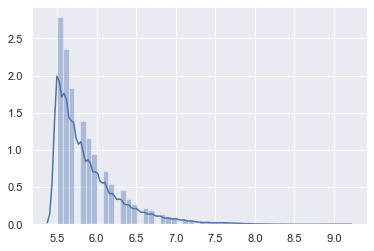

In [42]:
import seaborn as sns
%matplotlib inline 
sns.set()

sns.distplot(sf['Magnitude'])

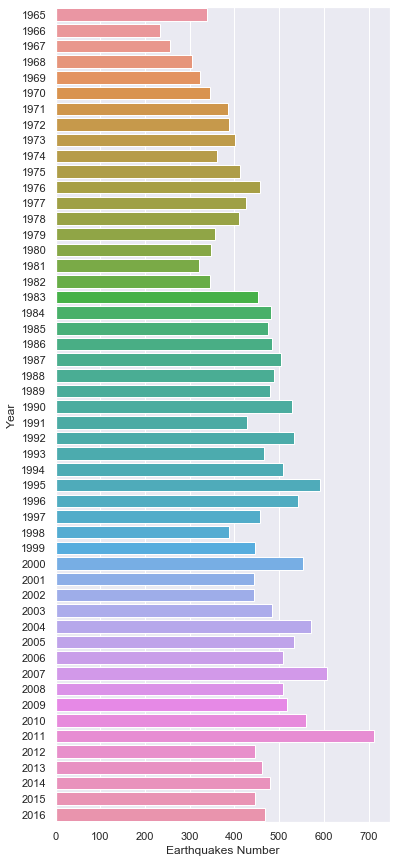

In [43]:
import dateutil
import turicreate.aggregate as agg

sf['Year'] = sf['Date'].apply(lambda dt: dateutil.parser.parse(dt).year)
g = sf.groupby('Year', {'Earthquakes Number':agg.COUNT()})
df = g.to_dataframe()

fig, ax = plt.subplots(figsize=(6,15))
sns.barplot(y='Year', x='Earthquakes Number',orient="h", data=df, ax=ax)

In [45]:
sf = sf['Date','Time','Latitude', 'Longitude', 'Magnitude']
b_sf = sf[sf['Magnitude'] > 8]
b_sf.sort('Magnitude', ascending=False)

Date,Time,Latitude,Longitude,Magnitude
12/26/2004,00:58:53,3.295,95.982,9.1
03/11/2011,05:46:24,38.297,142.373,9.1
02/27/2010,06:34:12,-36.122,-72.898,8.8
02/04/1965,05:01:22,51.251,178.715,8.7
04/11/2012,08:38:37,2.327,93.063,8.6
03/28/2005,16:09:37,2.085,97.108,8.6
09/12/2007,11:10:27,-4.438,101.367,8.4
06/23/2001,20:33:14,-16.265,-73.641,8.4
09/16/2015,22:54:33,-31.5729,-71.6744,8.3
05/24/2013,05:44:49,54.892,153.221,8.3


In [46]:
tiles = 'Stamen Terrain'
m = folium.Map(location=[0,0], zoom_start=2,
               tiles = tiles)

for r in b_sf:
    tooltip = f"{r['Date']} {r['Time']} - Magnitude: {r['Magnitude']} - Location ({(r['Latitude'],r['Longitude'])})" 
    folium.Marker(
        location=[r['Latitude'],r['Longitude']], # coordinates for the marker (Earth Lab at CU Boulder)
        popup= tooltip,
        icon=folium.Icon(color='red', icon='info-sign')
    ).add_to(m)
m  

Let's use the full dataset and create a heatmap of areas with many earthquakes:

In [47]:
import folium
from folium.plugins import HeatMap

tiles = 'Stamen Terrain'
m = folium.Map(location=[0,0], zoom_start=2,
               tiles = tiles)

data = [(r['Latitude'],r['Longitude']) for r in b_sf]
HeatMap(data, radius = 20).add_to(m)
m

In [48]:
import folium
from folium.plugins import HeatMap

tiles = 'Stamen Terrain'
m = folium.Map(location=[0,0], zoom_start=2,
               tiles = tiles)

data = [(r['Latitude'],r['Longitude'],r['Magnitude']) for r in sf]
HeatMap(data, radius = 20).add_to(m)
m

### 2.3.2 Visualizing UFO Sightings

In this section, we will use Folium to analyze the [UFO Sightings dataset](https://www.kaggle.com/NUFORC/ufo-sightings/kernels). First let's explore the data:

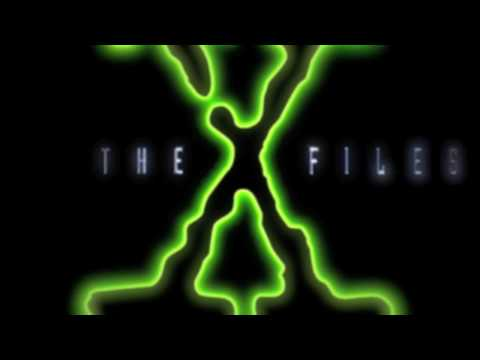

In [49]:
from IPython.lib.display import YouTubeVideo
YouTubeVideo('hAAlDoAtV7Y')

In [50]:
#!mkdir ./datasets
!mkdir ./datasets/ufo

# download the dataset from Kaggle and unzip it
!kaggle datasets download NUFORC/ufo-sightings  -p ./datasets/ufo

!unzip ./datasets/ufo/*.zip  -d ./datasets/ufo/

 98%|█████████████████████████████████████▏| 10.0M/10.2M [00:01<00:00, 5.84MB/s]
100%|██████████████████████████████████████| 10.2M/10.2M [00:01<00:00, 5.51MB/s]
Archive:  ./datasets/ufo/ufo-sightings.zip
  inflating: ./datasets/ufo/complete.csv  
  inflating: ./datasets/ufo/scrubbed.csv  


In [54]:
import turicreate as tc
import turicreate.aggregate as agg
import dateutil
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
sns.set()

sf = tc.SFrame.read_csv('./datasets/ufo/complete.csv')
sf

Unexpected characters after last column. "0"
Parse failed at token ending at: 
	5/5/2002 13:00,,,,,0,,,"Characteristics: Not aura or haze&#44 but more like emanation of an energy field.",5/24/2005,0,0^
Successfully parsed 11 tokens: 
	0: 5/5/2002 13:00
	1: 
	2: 
	3: 
	4: 
	5: 0
	6: 
	7: 
	8: Characteri ... rgy field.
	9: 5/24/2005
	10: 0

Unexpected characters after last column. "0"
Parse failed at token ending at: 
	3/30/2007 04:30,,ms,,,0,sphere,5 minutes,"White luminous Sphere",4/27/2007,0,0^
Successfully parsed 11 tokens: 
	0: 3/30/2007 04:30
	1: 
	2: ms
	3: 
	4: 
	5: 0
	6: sphere
	7: 5 minutes
	8: White luminous Sphere
	9: 4/27/2007
	10: 0

Unexpected characters after last column. "0"
Parse failed at token ending at: 
	3/31/1966 23:50,,,,,0,,,"Please refer to my report I reported to you 6/7/2001 and you posted on 8/5/2001.  Anyway&#44 do you know of any doctor that would remove t",10/30/2006,0,0^
Successfully parsed 11 tokens: 
	0: 3/31/1966 23:50
	1: 
	2: 
	3: 
	4: 
	5: 0
	6: 
	7: 
	8: Please ref ... d remove t
	9: 10/30/2006
	10: 0

Unexpected characters after last column. "0"
Parse failed at token ending at: 
	7/15/2013 21:00,,ms,,,0,formation,5 minutes,"My two children and I saw strange lights move around the sky. Antigravity type motion&#44silent&#44some suddenly vanished",8/30/2013,0,0^
Successfully parsed 11 tokens: 
	0: 7/15/2013 21:00
	1: 
	2: ms
	3: 
	4: 
	5: 0
	6: formation
	7: 5 minutes
	8: My two chi ... y vanished
	9: 8/30/2013
	10: 0

Unexpected characters after last column. "0"
Parse failed at token ending at: 
	1/26/2009 24:00,,,,,0,,,"I followed an FAA regulation&#44 and you went back on your word for me to remain anonymous. Now you&#39ve been removed from the 7110.65. HA&#33",3/19/2009,0,0^
Successfully parsed 11 tokens: 
	0: 1/26/2009 24:00
	1: 
	2: 
	3: 
	4: 
	5: 0
	6: 
	7: 
	8: I followed ... 65. HA&#33
	9: 3/19/2009
	10: 0

Unexpected characters after last column. "0"
Parse failed at token ending at: 
	3/31/2010 01:30,,nv,,,0,teardrop,,"unusual  flying objects taken by flash earth satalite  over nevada highway",11/21/2010,0,0^
Successfully parsed 11 tokens: 
	0: 3/31/2010 01:30
	1: 
	2: nv
	3: 
	4: 
	5: 0
	6: teardrop
	7: 
	8: unusual  f ... da highway
	9: 11/21/2010
	10: 0

Unexpected characters after last column. "0"
Parse failed at token ending at: 
	12/7/2002 14:00,,,,,0,circle,,"it was round made nosies i saw it uabove the sky.",12/23/2002,0,0^
Successfully parsed 11 tokens: 
	0: 12/7/2002 14:00
	1: 
	2: 
	3: 
	4: 
	5: 0
	6: circle
	7: 
	8: it was rou ... e the sky.
	9: 12/23/2002
	10: 0

Unexpected characters after last column. "0"
Parse failed at token ending at: 
	5/6/2008 02:00,,,,,0,circle,30 seconds,"it was early morning i was reading a book for some reason and i saw 5 circle shaped UFO&#39S in the sky that were moving rapidly through t",6/12/2008,0,0^
Successfully parsed 11 tokens: 
	0: 5/6/2008 02:00
	1: 
	2: 
	3: 
	4: 
	5: 0
	6: circle
	7: 30 seconds
	8: it was ear ...  through t
	9: 6/12/2008
	10: 0

Unexpected characters after last column. "0"
Parse failed at token ending at: 
	12/7/2008 12:07,,,,,0,,,"I was looking at a friends house and tilted the view up(north) and noticed what appears to be a classic shape of a &quot;space ship&quot;.",1/10/2009,0,0^
Successfully parsed 11 tokens: 
	0: 12/7/2008 12:07
	1: 
	2: 
	3: 
	4: 
	5: 0
	6: 
	7: 
	8: I was look ... hip&quot;.
	9: 1/10/2009
	10: 0

Unexpected characters after last column. "0"
Parse failed at token ending at: 
	11/20/2008 22:00,,tx,,,0,light,30 min,"10:00 pm= I saw 2 pair of lights. moments later one pair disapeared. another moment later I saw the other pair disapear &amp; I saw a air p",1/10/2009,0,0^
Successfully parsed 11 tokens: 
	0: 11/20/2008 22:00
	1: 
	2: tx
	3: 
	4: 
	5: 0
	6: light
	7: 30 min
	8: 10:00 pm=  ... aw a air p
	9: 1/10/2009
	10: 0

196 lines failed to parse correctly

Finished parsing file /Users/michael/Dropbox (BGU)/massive data mining/ 2020/notebooks/datasets/ufo/complete.csv

Parsing completed. Parsed 100 lines in 0.258661 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[str,str,str,str,str,int,str,str,str,float,float]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Unexpected characters after last column. "0"
Parse failed at token ending at: 
	5/5/2002 13:00,,,,,0,,,"Characteristics: Not aura or haze&#44 but more like emanation of an energy field.",5/24/2005,0,0^
Successfully parsed 11 tokens: 
	0: 5/5/2002 13:00
	1: 
	2: 
	3: 
	4: 
	5: 0
	6: 
	7: 
	8: Characteri ... rgy field.
	9: 5
	10: 0

Unexpected characters after last column. "0"
Parse failed at token ending at: 
	3/30/2007 04:30,,ms,,,0,sphere,5 minutes,"White luminous Sphere",4/27/2007,0,0^
Successfully parsed 11 tokens: 
	0: 3/30/2007 04:30
	1: 
	2: ms
	3: 
	4: 
	5: 0
	6: sphere
	7: 5 minutes
	8: White luminous Sphere
	9: 4
	10: 0

Unexpected characters after last column. "0"
Parse failed at token ending at: 
	3/31/1966 23:50,,,,,0,,,"Please refer to my report I reported to you 6/7/2001 and you posted on 8/5/2001.  Anyway&#44 do you know of any doctor that would remove t",10/30/2006,0,0^
Successfully parsed 11 tokens: 
	0: 3/31/1966 23:50
	1: 
	2: 
	3: 
	4: 
	5: 0
	6: 
	7: 
	8: Please ref ... d remove t
	9: 10
	10: 0

Unexpected characters after last column. "0"
Parse failed at token ending at: 
	7/15/2013 21:00,,ms,,,0,formation,5 minutes,"My two children and I saw strange lights move around the sky. Antigravity type motion&#44silent&#44some suddenly vanished",8/30/2013,0,0^
Successfully parsed 11 tokens: 
	0: 7/15/2013 21:00
	1: 
	2: ms
	3: 
	4: 
	5: 0
	6: formation
	7: 5 minutes
	8: My two chi ... y vanished
	9: 8
	10: 0

Unexpected characters after last column. "0"
Parse failed at token ending at: 
	3/31/2010 01:30,,nv,,,0,teardrop,,"unusual  flying objects taken by flash earth satalite  over nevada highway",11/21/2010,0,0^
Successfully parsed 11 tokens: 
	0: 3/31/2010 01:30
	1: 
	2: nv
	3: 
	4: 
	5: 0
	6: teardrop
	7: 
	8: unusual  f ... da highway
	9: 11
	10: 0

Unexpected characters after last column. "0"
Parse failed at token ending at: 
	1/26/2009 24:00,,,,,0,,,"I followed an FAA regulation&#44 and you went back on your word for me to remain anonymous. Now you&#39ve been removed from the 7110.65. HA&#33",3/19/2009,0,0^
Successfully parsed 11 tokens: 
	0: 1/26/2009 24:00
	1: 
	2: 
	3: 
	4: 
	5: 0
	6: 
	7: 
	8: I followed ... 65. HA&#33
	9: 3
	10: 0

Unexpected characters after last column. "0"
Parse failed at token ending at: 
	11/20/2008 22:00,,tx,,,0,light,30 min,"10:00 pm= I saw 2 pair of lights. moments later one pair disapeared. another moment later I saw the other pair disapear &amp; I saw a air p",1/10/2009,0,0^
Successfully parsed 11 tokens: 
	0: 11/20/2008 22:00
	1: 
	2: tx
	3: 
	4: 
	5: 0
	6: light
	7: 30 min
	8: 10:00 pm=  ... aw a air p
	9: 1
	10: 0

Unexpected characters after last column. "0"
Parse failed at token ending at: 
	5/6/2008 02:00,,,,,0,circle,30 seconds,"it was early morning i was reading a book for some reason and i saw 5 circle shaped UFO&#39S in the sky that were moving rapidly through t",6/12/2008,0,0^
Successfully parsed 11 tokens: 
	0: 5/6/2008 02:00
	1: 
	2: 
	3: 
	4: 
	5: 0
	6: circle
	7: 30 seconds
	8: it was ear ...  through t
	9: 6
	10: 0

Unexpected characters after last column. "0"
Parse failed at token ending at: 
	12/7/2002 14:00,,,,,0,circle,,"it was round made nosies i saw it uabove the sky.",12/23/2002,0,0^
Successfully parsed 11 tokens: 
	0: 12/7/2002 14:00
	1: 
	2: 
	3: 
	4: 
	5: 0
	6: circle
	7: 
	8: it was rou ... e the sky.
	9: 12
	10: 0

Unexpected characters after last column. "0"
Parse failed at token ending at: 
	12/7/2008 12:07,,,,,0,,,"I was looking at a friends house and tilted the view up(north) and noticed what appears to be a classic shape of a &quot;space ship&quot;.",1/10/2009,0,0^
Successfully parsed 11 tokens: 
	0: 12/7/2008 12:07
	1: 
	2: 
	3: 
	4: 
	5: 0
	6: 
	7: 
	8: I was look ... hip&quot;.
	9: 1
	10: 0

196 lines failed to parse correctly

Finished parsing file /Users/michael/Dropbox (BGU)/massive data mining/ 2020/notebooks/datasets/ufo/complete.csv

Parsing completed. Parsed 88679 lines in 0.303616 secs.

datetime,city,state,country,shape,duration (seconds),duration (hours/min)
10/10/1949 20:30,san marcos,tx,us,cylinder,2700,45 minutes
10/10/1949 21:00,lackland afb,tx,,light,7200,1-2 hrs
10/10/1955 17:00,chester (uk/england),,gb,circle,20,20 seconds
10/10/1956 21:00,edna,tx,us,circle,20,1/2 hour
10/10/1960 20:00,kaneohe,hi,us,light,900,15 minutes
10/10/1961 19:00,bristol,tn,us,sphere,300,5 minutes
10/10/1965 21:00,penarth (uk/wales),,gb,circle,180,about 3 mins
10/10/1965 23:45,norwalk,ct,us,disk,1200,20 minutes
10/10/1966 20:00,pell city,al,us,disk,180,3 minutes
10/10/1966 21:00,live oak,fl,us,disk,120,several minutes


In [55]:
def get_datetime(dt_str):
    try:
        return dateutil.parser.parse(dt_str)
    except:
        return None


sf['datetime'] = sf['datetime'].apply(lambda dt_str: get_datetime(dt_str))
sf = sf.dropna()
sf['Hour'] = sf['datetime'].apply(lambda dt: dt.hour)
sf['Month'] = sf['datetime'].apply(lambda dt: dt.month)
sf['Year'] = sf['datetime'].apply(lambda dt: dt.year)
sf['Decade'] = sf['Year'].apply(lambda y: y - y%10)

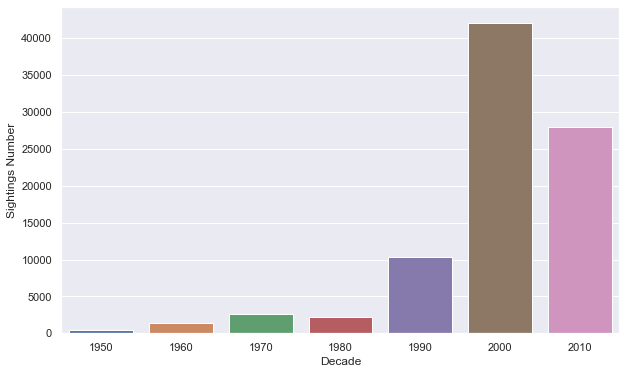

In [56]:
sf2 = sf[sf['Year'] >= 1950]
g = sf2.groupby('Decade', {'Sightings Number': agg.COUNT()})
df = g.to_dataframe()
fig, ax = plt.subplots(figsize=(10,6))
sns.barplot(x='Decade', y='Sightings Number', data=df, ax=ax)

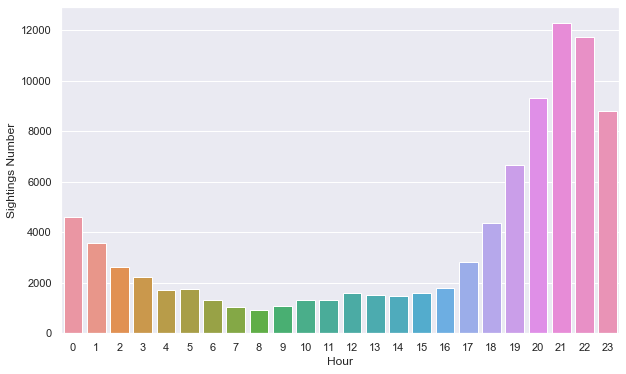

In [57]:
g = sf.groupby('Hour', {'Sightings Number': agg.COUNT()})
df = g.to_dataframe()
fig, ax = plt.subplots(figsize=(10,6))
sns.barplot(x='Hour', y='Sightings Number', data=df, ax=ax)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21]), <a list of 22 Text xticklabel objects>)

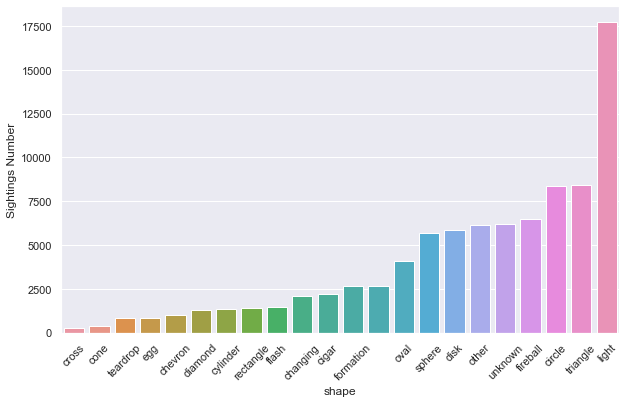

In [58]:
g = sf.groupby('shape', {'Sightings Number': agg.COUNT()})
g = g.sort('Sightings Number')
g = g[g['Sightings Number'] > 100]
df = g.to_dataframe()

fig, ax = plt.subplots(figsize=(10,6))

sns.barplot(x='shape', y='Sightings Number', data=df, ax=ax)
plt.xticks(rotation=45)

In [59]:
import folium
from folium.plugins import HeatMap

tiles = 'Stamen Terrain'
m = folium.Map(location=[0,0], zoom_start=2,
               tiles = tiles)

data = [(r['latitude'],r['longitude']) for r in sf]
HeatMap(data, radius = 20).add_to(m)
m

Let's visualize the sighting locations in 1993:

In [60]:
sf_80 = sf[sf['Decade'] == 1980]
len(sf_80)

2273

In [61]:
from folium.plugins import MarkerCluster
def pop_text(r):
    txt = f"<b>{r['datetime']}</b><br> {r['comments'][:500]}"
    return txt

m = folium.Map(zoom_start=8, tiles='CartoDB dark_matter')
mc = MarkerCluster()
for r in sf_80[:200]:
    mc.add_child(folium.CircleMarker(location=[r['latitude'],r['longitude']],
                        radius=5,color="#007849", popup=pop_text(r), parse_html=True))
m.add_child(mc)
m

In [62]:
def get_color(shape):
    if r['shape'] == 'circle':
         return 'red'
    if r['shape'] == 'triangle':
        return 'green'
    else:
        return 'blue'

s_sf = sf[sf['shape'].apply(lambda s: s in ['circle', 'triangle'])]
random_sample_sf, x = s_sf.random_split(0.1)

m = folium.Map(zoom_start=8, tiles='CartoDB dark_matter')
for r in random_sample_sf:
    m.add_child(folium.CircleMarker(location=[r['latitude'],r['longitude']],
                        radius=5,color=get_color(r['shape']), popup=pop_text(r), parse_html=True))
m

### 2.3.3 Working with TopoJSON

In this example, we are going to work with Folium and [TopoJSON](https://github.com/topojson/topojson).
Namely, we are going to draw an interactive choropleth map of the population in Washington state by county. 
First let's get data of [Washington state counties' population](https://data.wa.gov/Demographics/WAOFM-April-1-Population-by-State-County-and-City-/tecv-qzfm/data)
and [TopoJSON data](https://raw.githubusercontent.com/deldersveld/topojson/master/countries/us-states/WA-53-washington-counties.json)
with the counties' geographic data. Let's create a map that presents the population in each county:


In [65]:
#!mkdir ./datasets
!mkdir ./datasets/WA
!wget -O ./datasets/WA/population.csv https://data.wa.gov/api/views/2hia-rqet/rows.csv?accessType=DOWNLOAD
!wget -O ./datasets/WA/WA-53-washington-counties.json https://raw.githubusercontent.com/deldersveld/topojson/master/countries/us-states/WA-53-washington-counties.json

--2020-05-08 16:04:25--  https://data.wa.gov/api/views/2hia-rqet/rows.csv?accessType=DOWNLOAD
Resolving data.wa.gov (data.wa.gov)... 52.206.68.26, 52.206.140.205, 52.206.140.199
Connecting to data.wa.gov (data.wa.gov)|52.206.68.26|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [text/csv]
Saving to: ‘./datasets/WA/population.csv’

./datasets/WA/popul     [ <=>                ]  73.63K   449KB/s    in 0.2s    

2020-05-08 16:04:26 (449 KB/s) - ‘./datasets/WA/population.csv’ saved [75396]

--2020-05-08 16:04:26--  https://raw.githubusercontent.com/deldersveld/topojson/master/countries/us-states/WA-53-washington-counties.json
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.112.133
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.112.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 15542 (15K) [text/plain]
Saving to: ‘./datasets/WA/WA-53-washington-counties.json’

./data

In [70]:
import folium

datasets_path = "./datasets/WA"
tiles = 'Mapbox Bright'
m = folium.Map(
    location=[47.6117, -122.332],
    tiles=tiles,
    zoom_start=7
)
folium.Marker(
    location=[47.611700, -122.332000], # coordinates for the marker (Earth Lab at CU Boulder)
    popup='Here is Washington State', # pop-up label for the marker
    icon=folium.Icon()
).add_to(m)

#Create a layer of WAshington State Counties
topoJSONpath = f"{datasets_path}/WA-53-washington-counties.json"
folium.TopoJson(
    open(topoJSONpath),
    object_path='objects.cb_2015_washington_county_20m',

).add_to(m)
m




Now, let's use the counties' population data to create a choropleth map:

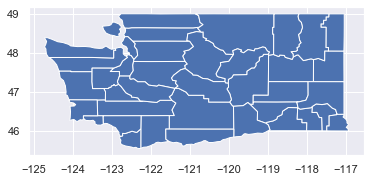

In [68]:
import geopandas as gpd
gdf = gpd.read_file(topoJSONpath)

gdf.plot()


In [69]:
gdf.head()

,id,STATEFP,COUNTYFP,COUNTYNS,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry
0,None,53,063,01529225,0500000US53063,53063,Spokane,06,4568197031,43789502,"POLYGON ((-117.82144 47.82584, -117.69950 47.8..."
1,None,53,041,01531927,0500000US53041,53041,Lewis,06,6223223859,86636988,"POLYGON ((-123.37212 46.79151, -123.20424 46.7..."
2,None,53,025,01531924,0500000US53025,53025,Grant,06,6939890129,289550821,"POLYGON ((-120.00743 47.22020, -120.00566 47.3..."
3,None,53,051,01529157,0500000US53051,53051,Pend Oreille,06,3626035232,65404066,"POLYGON ((-117.42912 48.99974, -117.26831 48.9..."
4,None,53,023,01533500,0500000US53023,53023,Garfield,06,1840672367,19490299,"POLYGON ((-117.85325 46.62453, -117.75075 46.6..."


In [73]:
import pandas as pd
wa_pop_path = f"{datasets_path}/population.csv"
df = pd.read_csv(wa_pop_path)
df 

,SEQUENCE,FILTER,COUNTY,JURISDICTION,POP_1990,POP_1991,POP_1992,POP_1993,POP_1994,POP_1995,...,POP_2010,POP_2011,POP_2012,POP_2013,POP_2014,POP_2015,POP_2016,POP_2017,POP_2018,POP_2019
0,1,1,Adams,Adams County,13603.0,13823.0,14063.0,14335.0,14679.0,15030.0,...,18728,18950,19050,19200,19400,19410,19510,19870,20020,20150
1,2,2,Adams,Unincorporated Adams County,6466.0,6698.0,6776.0,7009.0,7162.0,7303.0,...,8818,8960,8980,9040,9135,9085,9105,9165,9220,9270
2,3,3,Adams,Incorporated Adams County,7137.0,7125.0,7287.0,7326.0,7517.0,7727.0,...,9910,9990,10070,10160,10265,10325,10405,10705,10800,10880
3,4,4,Adams,Hatton,71.0,80.0,81.0,82.0,83.0,84.0,...,101,100,105,110,110,110,110,110,110,115
4,5,4,Adams,Lind,472.0,400.0,523.0,435.0,452.0,451.0,...,564,560,565,570,565,560,550,550,550,550
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
404,405,4,Yakima,Yakima,54843.0,58925.0,60455.0,61693.0,62387.0,63930.0,...,91196,91630,91930,92620,93080,93220,93410,93900,94190,94440
405,406,4,Yakima,Zillah,1911.0,1922.0,1938.0,1991.0,2062.0,2096.0,...,2964,3000,3035,3115,3140,3140,3145,3150,3165,3185
406,407,1,Washington,State Total,4866659.0,5000353.0,5091138.0,5188009.0,5291577.0,5396569.0,...,6724540,6767900,6817770,6882400,6968170,7061410,7183700,7310300,7427570,7546410
407,408,2,Washington,Unincorporated State Total,2341365.0,2394824.0,2438904.0,2435178.0,2475442.0,2507091.0,...,2478323,2454633,2438547,2449701,2470761,2497039,2516902,2557466,2591085,2635501


In [75]:
import turicreate as tc
import turicreate.aggregate as agg
import pandas as pd


sf = tc.SFrame.read_csv(wa_pop_path)
sf = sf[sf['JURISDICTION'].apply(lambda j: "corporated" not in j)]
sf

Finished parsing file /Users/michael/Dropbox (BGU)/massive data mining/ 2020/notebooks/datasets/WA/population.csv

Parsing completed. Parsed 100 lines in 0.00683 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[int,int,str,str,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Finished parsing file /Users/michael/Dropbox (BGU)/massive data mining/ 2020/notebooks/datasets/WA/population.csv

Parsing completed. Parsed 409 lines in 0.006773 secs.

SEQUENCE,FILTER,COUNTY,JURISDICTION,POP_1990,POP_1991,POP_1992,POP_1993,POP_1994,POP_1995,POP_1996
1,1,Adams,Adams County,13603,13823,14063,14335,14679,15030,15323
4,4,Adams,Hatton,71,80,81,82,83,84,93
5,4,Adams,Lind,472,400,523,435,452,451,484
6,4,Adams,Othello,4638,4692,4735,4868,5033,5240,5265
7,4,Adams,Ritzville,1725,1728,1730,1729,1730,1733,1733
8,4,Adams,Washtucna,231,225,218,212,219,219,218
9,1,Asotin,Asotin County,17605,17677,17866,18124,18666,18937,19622
12,4,Asotin,Asotin,981,1039,1046,1002,1017,1072,1086
13,4,Asotin,Clarkston,6753,6632,6762,6771,7128,6748,6982
14,1,Benton,Benton County,112560,114439,116503,119374,123457,128359,132590


In [82]:
sf = sf[sf["FILTER"] == 1]
sf

SEQUENCE,FILTER,COUNTY,JURISDICTION,POP_1990,POP_1991,POP_1992,POP_1993,POP_1994,POP_1995
1,1,Adams,Adams County,13603,13823,14063,14335,14679,15030
9,1,Asotin,Asotin County,17605,17677,17866,18124,18666,18937
14,1,Benton,Benton County,112560,114439,116503,119374,123457,128359
22,1,Chelan,Chelan County,52250,53436,54965,56423,58319,60079
30,1,Clallam,Clallam County,56210,57626,58275,59155,59919,60548
36,1,Clark,Clark County,238053,248417,255915,264548,274423,286804
47,1,Columbia,Columbia County,4024,4044,4041,4047,4053,4051
52,1,Cowlitz,Cowlitz County,82119,82862,83802,84813,85921,87232
60,1,Douglas,Douglas County,26195,27648,27423,28143,28692,29312
69,1,Ferry,Ferry County,6295,6366,6465,6561,6648,6812


In [83]:
total_wa = sf['POP_2019'].sum()
sf['Pop Percentage'] = sf['POP_2019'].apply(lambda p: p/float(total_wa))
sf = sf.rename({"COUNTY":"NAME"})
gsf = tc.SFrame(gdf[['GEOID', 'NAME']]) 
g = sf.join(gsf, on="NAME")
g.sort('Pop Percentage', ascending=False)


SEQUENCE,FILTER,NAME,JURISDICTION,POP_1990,POP_1991,POP_1992,POP_1993,POP_1994,POP_1995
124,1,King,King County,1507305,1549991,1570997,1590603,1609529,1625241
245,1,Pierce,Pierce County,586203,598065,610619,623697,636802,649284
292,1,Snohomish,Snohomish County,465628,488075,496461,507336,519960,531704
315,1,Spokane,Spokane County,361333,365887,371147,377020,384035,391318
36,1,Clark,Clark County,238053,248417,255915,264548,274423,286804
340,1,Thurston,Thurston County,161238,167663,172425,177058,181715,186419
166,1,Kitsap,Kitsap County,189731,196926,202113,207976,212429,218308
390,1,Yakima,Yakima County,188823,191490,194939,198225,202044,206046
361,1,Whatcom,Whatcom County,127780,132669,137791,141270,146056,149942
14,1,Benton,Benton County,112560,114439,116503,119374,123457,128359


In [84]:
tiles = 'Mapbox Bright'
m = folium.Map(
    location=[47.6117, -122.332],
    tiles=tiles,
    zoom_start=7
)

#Create a layer of WAshington State Counties
topoJSONpath = f"{datasets_path}/WA-53-washington-counties.json"
folium.Choropleth(
    geo_data=open(topoJSONpath,"r"),
    topojson='objects.cb_2015_washington_county_20m',
    data=g.to_dataframe(),
    columns=['GEOID', 'Pop Percentage'],
    key_on='properties.GEOID',
    fill_color='BuPu',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Population Percentage',
    reset=True
).add_to(m)
folium.LayerControl().add_to(m)

m

## 2.4 Working with Plotly-Express

In this section, we are going to create an interactive map using [Plotly-Express](https://medium.com/@plotlygraphs/introducing-plotly-express-808df010143d), using data from [WikiTree](https://www.wikitree.com/wiki/Help:Database_Dumps). Our goal is to create a map of the most common birth locations
over time. Let's start by loading the data into an SFrame object:


In [41]:
import turicreate as tc
import turicreate.aggregate as agg

sf = tc.SFrame.read_csv('./datasets/wikitree_birth_locations.csv', verbose=True)
# sf['Birth Location'] = sf['Birth Location'].apply(lambda s: s.strip().lower() if len(s.lower()) > 1 else None)
sf

Finished parsing file /Users/michael/Dropbox (BGU)/massive data mining/datasets/wikitree_birth_locations.csv

Parsing completed. Parsed 100 lines in 0.418882 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[int,str]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Read 2252637 lines. Lines per second: 2.81638e+06

Finished parsing file /Users/michael/Dropbox (BGU)/massive data mining/datasets/wikitree_birth_locations.csv

Parsing completed. Parsed 16420973 lines in 4.60602 secs.

Birth Date,Birth Location
0,
1940,
1920,
1920,
1940,
1910,
1920,
1940,
1940,
18870921,"Canning, Kings, NovaScotia, Canada ..."


In [42]:
def get_year(s):
    if len(s) < 4:
        return None
    if len(s) == 4:
        return int(s)
    return int(s[:4])
    
sf['Year'] = sf['Birth Date'].apply(lambda s: get_year(str(s)))
sf = sf[sf['Year'] < 2019]
sf = sf[sf['Year'] >= 0]
sf = sf.dropna()
print("Unique locations number %s" % len(sf['Birth Location'].unique()))

Unique locations number 1691018


We have too many locations (at least for this example). Let's filter out places that with less than 50 births:

In [43]:
g = sf.groupby('Birth Location', {'count': agg.COUNT()})
g = g[g['count'] > 50]
len(g)

23420

We have about over 23,500 locations, so let's reolve each location's and find each location longitude and latitude:

In [44]:
from geopy import Bing
BING_MAPS_API_KEY = open("../../env/.keys").read()
b = Bing(BING_MAPS_API_KEY)
r = b.geocode("New York")
r

Location(New York, NY, United States, (40.71455001831055, -74.00714111328125, 0.0))

In [45]:
r.raw

{'__type': 'Location:http://schemas.microsoft.com/search/local/ws/rest/v1',
 'bbox': [40.363765716552734,
  -74.74592590332031,
  41.0565299987793,
  -73.26721954345703],
 'name': 'New York, NY',
 'point': {'type': 'Point',
  'coordinates': [40.71455001831055, -74.00714111328125]},
 'address': {'adminDistrict': 'NY',
  'countryRegion': 'United States',
  'formattedAddress': 'New York, NY',
  'locality': 'New York'},
 'confidence': 'High',
 'entityType': 'PopulatedPlace',
 'geocodePoints': [{'type': 'Point',
   'coordinates': [40.71455001831055, -74.00714111328125],
   'calculationMethod': 'Rooftop',
   'usageTypes': ['Display']}],
 'matchCodes': ['Good']}

Let's resolve the top-mentioned locations and insert each location into a MongoDB collection. Let's create a collection and insert to it
a single location data:

In [46]:
import pymongo
client = pymongo.MongoClient("mongodb://localhost:27017/")
db = client['locations'] # Created a new DB named locations
collection = db['wikitree_locatios'] 

j = {'raw': r.raw, 'result': str(r), "query": "New York"}
collection.insert_one(j)
# Creating a index for faster search
collection.create_index([('query', pymongo.TEXT)], name='location_query_index', default_language='english')

'location_query_index'

In [47]:
from geopy.exc import GeocoderTimedOut
import time

def find_location(collection, query , search_bing=True):
    result = collection.find_one({'query': query})
    if result is None and search_bing:
        try:
            result = b.geocode(query)
            result = add_location(collection, query, result)
        except:
            time.sleep(5)
            pass
            
    return result

def add_location(collection, query, result):
    if result is not None:
        j = {'raw': result.raw, 'result': str(result), "query": query}
    else:
        j = {'raw': {}, 'result': None, "query": query}
    collection.insert_one(j)
    return j

find_location(collection, "Italy")

{'_id': ObjectId('5ca26c697a00fc082e44119f'),
 'raw': {'__type': 'Location:http://schemas.microsoft.com/search/local/ws/rest/v1',
  'bbox': [36.67594528198242,
   1.228389024734497,
   47.06735610961914,
   23.807432174682617],
  'name': 'Italy',
  'point': {'type': 'Point',
   'coordinates': [43.529029846191406, 12.16218376159668]},
  'address': {'countryRegion': 'Italy', 'formattedAddress': 'Italy'},
  'confidence': 'High',
  'entityType': 'CountryRegion',
  'geocodePoints': [{'type': 'Point',
    'coordinates': [43.529029846191406, 12.16218376159668],
    'calculationMethod': 'Rooftop',
    'usageTypes': ['Display']}],
  'matchCodes': ['Good']},
 'result': 'Italy',
 'query': 'Italy'}

In [48]:
from tqdm import tqdm_notebook as tqdm
n =5000
g = g.sort('count', ascending=False)
l = list(g['Birth Location'])[:n]
for loc in tqdm(l):
    find_location(collection, loc)

In [49]:
from functools import lru_cache

@lru_cache(maxsize=None)
def get_country(query):
    r = find_location(collection, query)
    try:
        return r['raw']['address']['countryRegion']
    except:
        return None

locations_set = set(l)
sf2 = sf[sf['Birth Location'].apply(lambda loc: loc in locations_set)]
countries = []
for loc in tqdm(sf2['Birth Location']):
    countries.append(get_country( loc ))
sf2['Country'] = countries 
sf2

Birth Date,Birth Location,Year,Country
1940,,1940,None
1920,,1920,None
1920,,1920,None
1940,,1940,None
1910,,1910,None
1920,,1920,None
1940,,1940,None
1940,,1940,None
1910,,1910,None
1920,,1920,None


In [53]:
import plotly_express as px
import pycountry

def get_country_to_alpha3(name):
    if name == 'Czech Republic':
        return 'CZE'
    if name == 'Russia':
        return 'RUS'


    try:
        return pycountry.countries.get(name=name).alpha_3
    except:
        return None
    
sf2 = sf2.dropna()
g2 = sf2.groupby(['Year','Country'], {'Count': agg.COUNT()})
g3 = g2[g2['Year'] >= 1400]
g3['alpha3'] = g3['Country'].apply(lambda c: get_country_to_alpha3(c))
g3 = g3.dropna()
g3 = g3[g3['Year'] >= 1750]
g3 = g3[g3['Year'] <= 1950]
px.scatter_geo(g3.to_dataframe(), locations="alpha3", hover_name="Country", size="Count",
               animation_frame="Year", projection="natural earth")

In [54]:
us_sf = sf2[sf2['Country'] == 'United States']
us_sf.materialize()
us_sf

Birth Date,Birth Location,Year,Country
19200714,Massachusetts,1920,United States
18791130,Massachusetts,1879,United States
19230926,"Boston, MA",1923,United States
19010524,"Boston, Massachusetts,United States ...",1901,United States
19030118,"Cambridge, Massachusetts",1903,United States
19120000,Massachusetts,1912,United States
18900828,"New York City, New York,United States ...",1890,United States
18660200,"New York, NY",1866,United States
18461100,Massachusetts,1846,United States
19280422,"Worcester, Massachusetts",1928,United States


In [55]:
us_g = us_sf.groupby(['Year','Birth Location'], {"Count": agg.COUNT()})
us_g

Birth Location,Year,Count
"Smith County, Tennessee,USA ...",1887,1
"Perry, Ohio, UnitedStates ...",1891,1
"Giles, Tennessee, USA",1824,3
"Jersey City, Hudson, NewJersey ...",1918,3
"Cabell County, WestVirginia ...",1837,4
"Cabarrus County, NorthCarolina, United States ...",1873,3
"Harwich, Barnstable,Massachusetts ...",1716,3
"Cumberland, Pennsylvania",1712,2
"St. Louis, Missouri",1844,4
"Germantown, Philadelphia,Pennsylvania ...",1769,2


In [56]:
@lru_cache(maxsize=None)
def get_long_lat(query):
    r = find_location(collection, query)
    try:
        return r['raw']['point']['coordinates']
    except:
        return None
    
@lru_cache(maxsize=None)
def get_state(query):
    r = find_location(collection, query)
    try:
        return r['raw']['address']['adminDistrict']
    except:
        return None
    
state_l = []
cor_l = []
for loc in tqdm(us_g['Birth Location']):
    cor_l.append(get_long_lat(loc))
    state_l.append(get_state(loc))
us_g['Cooridnates'] = cor_l
us_g['State'] = state_l
us_g = us_g.dropna()
us_g

Birth Location,Year,Count,Cooridnates,State
"Smith County, Tennessee,USA ...",1887,1,"[36.250572204589844,-85.95669555664062] ...",TN
"Perry, Ohio, UnitedStates ...",1891,1,"[41.771671295166016,-81.14666748046875] ...",OH
"Giles, Tennessee, USA",1824,3,"[35.202117919921875,-87.03473663330078] ...",TN
"Jersey City, Hudson, NewJersey ...",1918,3,"[40.71747970581055,-74.04385375976562] ...",NJ
"Cabell County, WestVirginia ...",1837,4,"[38.42015075683594,-82.24178314208984] ...",WV
"Cabarrus County, NorthCarolina, United States ...",1873,3,"[35.3868408203125,-80.55193328857422] ...",NC
"Harwich, Barnstable,Massachusetts ...",1716,3,"[41.68627166748047,-70.07341766357422] ...",MA
"Cumberland, Pennsylvania",1712,2,"[39.76728057861328,-77.27111053466797] ...",PA
"St. Louis, Missouri",1844,4,"[38.627750396728516,-90.1995620727539] ...",MO
"Germantown, Philadelphia,Pennsylvania ...",1769,2,"[40.029541015625,-75.17510986328125] ...",PA


In [57]:
df = us_g[us_g['Year'] == 1900].to_dataframe()
px.choropleth(df, locations='State', locationmode='USA-states', color='Count')

In [58]:
us_g = us_g.sort('Year')
df = us_g.to_dataframe()
px.choropleth(df, locations='State', locationmode='USA-states', color='Count', animation_frame='Year')

## 2.5 Using Kepler.gl

Let's load the [2016 Parties in New York](https://www.kaggle.com/somesnm/partynyc) to an SFrame object:

In [85]:
#!mkdir ./datasets
!mkdir ./datasets/partynyc

# download the dataset from Kaggle and unzip it
!kaggle datasets download somesnm/partynyc  -p ./datasets/partynyc

!unzip ./datasets/partynyc/*.zip  -d ./datasets/partynyc/

 97%|████████████████████████████████████▉ | 14.0M/14.4M [00:04<00:00, 5.57MB/s]
100%|██████████████████████████████████████| 14.4M/14.4M [00:04<00:00, 3.45MB/s]
Archive:  ./datasets/partynyc/partynyc.zip
  inflating: ./datasets/partynyc/bar_locations.csv  
  inflating: ./datasets/partynyc/party_in_nyc.csv  
  inflating: ./datasets/partynyc/test_parties.csv  
  inflating: ./datasets/partynyc/train_parties.csv  


In [86]:
import turicreate as tc
import turicreate.aggregate as agg

sf = tc.SFrame.read_csv("./datasets/partynyc/party_in_nyc.csv")
sf

Finished parsing file /Users/michael/Dropbox (BGU)/massive data mining/ 2020/notebooks/datasets/partynyc/party_in_nyc.csv

Parsing completed. Parsed 100 lines in 0.367555 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[str,str,str,float,str,str,float,float]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Finished parsing file /Users/michael/Dropbox (BGU)/massive data mining/ 2020/notebooks/datasets/partynyc/party_in_nyc.csv

Parsing completed. Parsed 225414 lines in 0.368045 secs.

Created Date,Closed Date,Location Type,Incident Zip,City,Borough
2015-12-31 00:01:15,2015-12-31 03:48:04,Store/Commercial,10034.0,NEW YORK,MANHATTAN
2015-12-31 00:02:48,2015-12-31 04:36:13,Store/Commercial,10040.0,NEW YORK,MANHATTAN
2015-12-31 00:03:25,2015-12-31 00:40:15,ResidentialBuilding/House ...,10026.0,NEW YORK,MANHATTAN
2015-12-31 00:03:26,2015-12-31 01:53:38,ResidentialBuilding/House ...,11231.0,BROOKLYN,BROOKLYN
2015-12-31 00:05:10,2015-12-31 03:49:10,ResidentialBuilding/House ...,10033.0,NEW YORK,MANHATTAN
2015-12-31 00:08:05,2015-12-31 01:59:12,ResidentialBuilding/House ...,10467.0,BRONX,BRONX
2015-12-31 00:11:40,2015-12-31 06:24:00,ResidentialBuilding/House ...,11230.0,BROOKLYN,BROOKLYN
2015-12-31 00:12:13,2015-12-31 00:38:09,ResidentialBuilding/House ...,11215.0,BROOKLYN,BROOKLYN
2015-12-31 00:12:37,2015-12-31 05:03:39,ResidentialBuilding/House ...,10463.0,BRONX,BRONX
2015-12-31 00:14:13,2015-12-31 06:25:40,Store/Commercial,11372.0,JACKSON HEIGHTS,QUEENS


In [87]:
sf['Latitude'] = sf['Latitude'].apply(lambda i: round(i,4))
sf['Longitude'] = sf['Longitude'].apply(lambda i: round(i,4))
sf = sf.dropna()
g = sf.groupby(['Latitude','Longitude'], {'Count': agg.COUNT()})
g.sort('Count', ascending=False)
g.export_csv("./parties_location_count.csv")
g[g['Count'] >= 50].export_csv("./parties_location_count_50.csv")

In [88]:
g

Latitude,Longitude,Count
40.6693,-73.8848,1
40.8707,-73.8901,6
40.8793,-73.8599,28
40.6862,-73.872,4
40.688,-73.8317,2
40.869,-73.9028,16
40.6657,-73.772,1
40.8558,-73.9056,2
40.645,-73.946,2
40.8487,-73.9059,19


Let's use Kepler.gl to visualize the data:

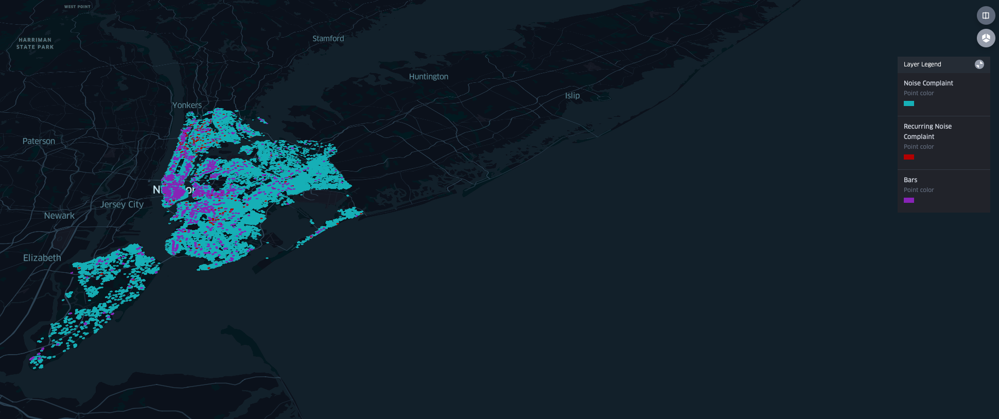

In [43]:
from IPython.display import Image
Image("./kepler.gl_party.png")

### 2.6 Working with BaseMap

In this section, we are going to use [BaseMap](https://matplotlib.org/basemap/). Let's first install BaseMap using Conda:
```console
!conda install basemap
```

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


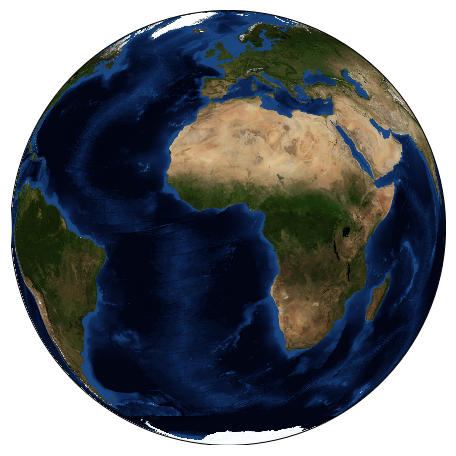

In [11]:
# In case a problem with PROJ_LIB
# than install conda install proj4 and set PROJ_LIB to the share/proj directory
#import os
# os.environ["PROJ_LIB"] = "/anaconda3/pkgs/proj4-<complete path>/share/proj" # or
import matplotlib.pyplot as plt
from mpl_toolkits.basemap import Basemap
import matplotlib.pyplot as plt
%matplotlib inline

plt.figure(figsize=(8, 8))
m = Basemap(projection='ortho', resolution=None, lat_0=0, lon_0=0)
m.bluemarble(scale=0.5);

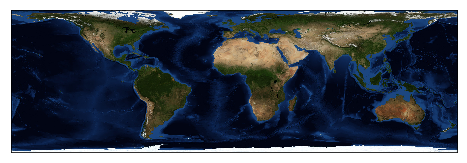

In [5]:
plt.figure(figsize=(8, 8))
m = Basemap(projection='cea', resolution=None)
m.bluemarble(scale=1);

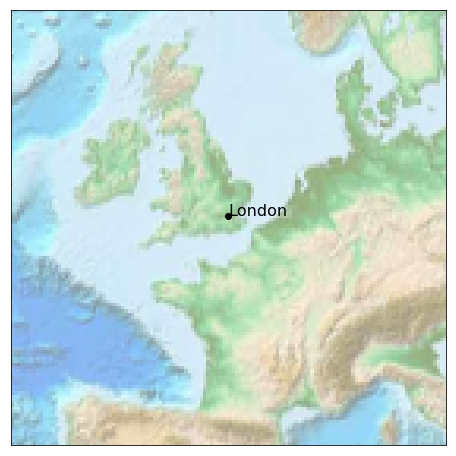

In [6]:
# inspired from https://jakevdp.github.io/PythonDataScienceHandbook/04.13-geographic-data-with-basemap.html
fig = plt.figure(figsize=(8, 8))
m = Basemap(projection='lcc', resolution='h',
            width=2E6, height=2E6, 
            lat_0=51, lon_0=0.12,)
m.etopo(scale=0.51, alpha=0.5)

# Map (long, lat) to (x, y) for plotting
x, y = m(0.1278, 51.5074)
plt.plot(x, y, 'ok', markersize=6)
plt.text(x, y, 'London', fontsize=16);

Using BaseMap, we can plot maps with different resolutions and colors:

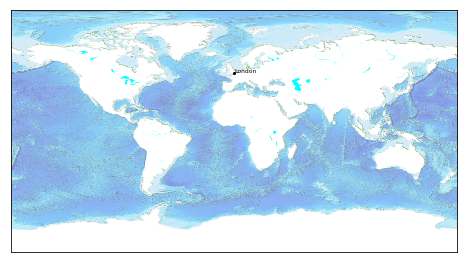

In [7]:
fig = plt.figure(figsize=(8, 8))
m = Basemap(projection='gall', resolution='c')
m.etopo(scale=0.51, alpha=0.5)
m.fillcontinents(color='white',lake_color='aqua')
# Map (long, lat) to (x, y) for plotting
x, y = m(0.1278, 51.5074)
plt.plot(x, y, 'ok', markersize=2)
plt.text(x, y, 'London', fontsize=6);

Each map projection has its own advantages and disadvantages. 
In BaseMap there are  [24 different map projections](https://matplotlib.org/basemap/users/mapsetup.html).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


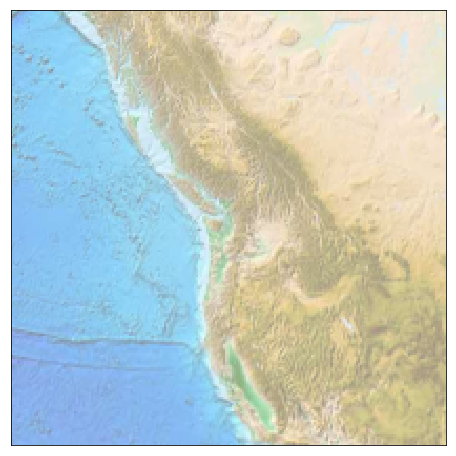

In [20]:
fig = plt.figure(figsize=(8, 8))
m = Basemap(projection='gnom', resolution='c',
            width=3E6, height=3E6, 
            lat_0=47.608013, lon_0=-122.335167)
m.etopo(scale=0.51, alpha=0.5)